In [1]:
import numpy as np
import pandas as pd
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 90)

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")

from sklearn.neighbors import KNeighborsRegressor
import scipy.stats
from sklearn.preprocessing import StandardScaler
from pycaret.regression import setup, compare_models
from sklearn.model_selection import KFold, cross_val_score

from catboost import CatBoostRegressor
from sklearn.linear_model import BayesianRidge, HuberRegressor, Ridge, OrthogonalMatchingPursuit
from lightgbm import LGBMRegressor
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor
from xgboost import XGBRegressor

import optuna

In [2]:
train0 = pd.read_csv("train.csv")
test0 = pd.read_csv("test.csv")

In [3]:
train0

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,None,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,Gas

In [4]:
test0

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454,2915,160,RM,21.0,1936,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,2Story,4,7,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,546.0,546.0,GasA,Gd,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2006,WD,Normal
1455,2916,160,RM,21.0,1894,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,TwnhsE,2Story,4,5,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,252.0,Unf,0.0,294.0,546.0,GasA,TA,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,6,Typ,0,NaN,CarPort,1970.0,Unf,1.0,286.0,TA,TA,Y,0,24,0,0,0,0,NaN,NaN,NaN,0,4,2006,WD,Abnorml
1456,2917,20,RL,160.0,20000,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,7,1960,1996,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,1224.0,Unf,0.0,0.0,1224.0,GasA,Ex,Y,SBrkr,1224,0,0,1224,1.0,0.0,1,0,4,1,TA,7,Typ,1,TA,Detchd,1960.0,Unf,2.0,576.0,TA,TA,Y,474,0,0,0,0,0,NaN,NaN,NaN,0,9,2006,WD,Abnorml
1457,2918,85,RL,62.0,10441,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,SFoyer,5,5,1992,1992,Gable,Comp

### Combine Train and Test Sets

In [5]:
target = train0["SalePrice"]
test_ids = test0["Id"]

train1 = train0.drop(["Id","SalePrice"], axis=1)
test1 = test0.drop(["Id"], axis=1)

data1 = pd.concat([train1, test1], axis=0).reset_index(drop=True)
data1

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal
1,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal
2,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal
3,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml
4,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,160,RM,21.0,1936,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,2Story,4,7,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,546.0,546.0,GasA,Gd,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2006,WD,Normal
2915,160,RM,21.0,1894,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,TwnhsE,2Story,4,5,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,252.0,Unf,0.0,294.0,546.0,GasA,TA,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,6,Typ,0,NaN,CarPort,1970.0,Unf,1.0,286.0,TA,TA,Y,0,24,0,0,0,0,NaN,NaN,NaN,0,4,2006,WD,Abnorml
2916,20,RL,160.0,20000,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,7,1960,1996,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,1224.0,Unf,0.0,0.0,1224.0,GasA,Ex,Y,SBrkr,1224,0,0,1224,1.0,0.0,1,0,4,1,TA,7,Typ,1,TA,Detchd,1960.0,Unf,2.0,576.0,TA,TA,Y,474,0,0,0,0,0,NaN,NaN,NaN,0,9,2006,WD,Abnorml
2917,85,RL,62.0,10441,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,SFoyer,5,5,1992,1992,Gable,CompShg,HdBoard,Wd Shng,None,0.0,TA,TA,PConc,Gd,TA,Av,GLQ,337.0,Un

In [6]:
target

0       208500
1       181500
2       223500
3       140000
4       250000
         ...  
1455    175000
1456    210000
1457    266500
1458    142125
1459    147500
Name: SalePrice, Length: 1460, dtype: int64

### Cleaning

In [7]:
data2 = data1.copy()

### Ensure Proper Data Types

In [8]:
data2.select_dtypes(include=np.number)

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold
0,60,65.0,8450,7,5,2003,2003,196.0,706.0,0.0,150.0,856.0,856,854,0,1710,1.0,0.0,2,1,3,1,8,0,2003.0,2.0,548.0,0,61,0,0,0,0,0,2,2008
1,20,80.0,9600,6,8,1976,1976,0.0,978.0,0.0,284.0,1262.0,1262,0,0,1262,0.0,1.0,2,0,3,1,6,1,1976.0,2.0,460.0,298,0,0,0,0,0,0,5,2007
2,60,68.0,11250,7,5,2001,2002,162.0,486.0,0.0,434.0,920.0,920,866,0,1786,1.0,0.0,2,1,3,1,6,1,2001.0,2.0,608.0,0,42,0,0,0,0,0,9,2008
3,70,60.0,9550,7,5,1915,1970,0.0,216.0,0.0,540.0,756.0,961,756,0,1717,1.0,0.0,1,0,3,1,7,1,1998.0,3.0,642.0,0,35,272,0,0,0,0,2,2006
4,60,84.0,14260,8,5,2000,2000,350.0,655.0,0.0,490.0,1145.0,1145,1053,0,2198,1.0,0.0,2,1,4,1,9,1,2000.0,3.0,836.0,192,84,0,0,0,0,0,12,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,160,21.0,1936,4,7,1970,1970,0.0,0.0,0.0,546.0,546.0,546,546,0,1092,0.0,0.0,1,1,3,1,5,0,NaN,0.0,0.0,0,0,0,0,0,0,0,6,2006
2915,160,21.0,1894,4,5,1970,1970,0.0,252.0,0.0,294.0,546.0,546,546,0,1092,0.0,0.0,1,1,3,1,6,0,1970.0,1.0,286.0,0,24,0,0,0,0,0,4,2006
2916,20,160.0,20000,5,7,1960,1996,0.0,1224.0,0.0,0.0,1224.0,1224,0,0,1224,1.0,0.0,1,0,4,1,7,1,1960.0,2.0,576.0,474,0,0,0,0,0,0,9,2006
2917,85,62.0,10441,5,5,1992,1992,0.0,337.0,0.0,575.0,912.0,970,0,0,970,0.0,1.0,1,0,3,1,6,0,NaN,0.0,0.0,80,32,0,0,0,0,700,7,2006


In [9]:
# Convert MSSubClass to string because it is categorical but looks like a number
data2["MSSubClass"] = data2["MSSubClass"].astype(str)

### Fill Categorical Missing Values

In [10]:
# Show columns list with missing values in categorical columns
data2.select_dtypes("object").loc[:, data2.isna().sum()>0].columns

Index(['MSZoning', 'Alley', 'Utilities', 'Exterior1st', 'Exterior2nd',
       'MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1',
       'BsmtFinType2', 'Electrical', 'KitchenQual', 'Functional',
       'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond',
       'PoolQC', 'Fence', 'MiscFeature', 'SaleType'],
      dtype='object')

In [11]:
for column in [
    "Alley",
    "BsmtQual",
    "BsmtCond",
    "BsmtExposure",
    "BsmtFinType1",
    "BsmtFinType2",
    "FireplaceQu",
    "GarageType",
    "GarageFinish",
    "GarageQual",
    "GarageCond",
    "PoolQC",
    "Fence",
    "MiscFeature",
]:
    data2[column] = data2[column].fillna("None")

for column in [
    "MSZoning",
    "Utilities",
    "Exterior1st",
    "Exterior2nd",
    "MasVnrType",
    "Electrical",
    "KitchenQual",
    "Functional",
    "SaleType",
]:
    data2[column] = data2[column].fillna(data2[column].mode()[0])

In [12]:
# Show columns list with missing values in categorical columns
data2.select_dtypes("object").isna().sum().sum()

0

In [13]:
# Show columns with missing values in numerical columns
data2.select_dtypes(np.number).isna().sum()[data2.select_dtypes(np.number).isna().sum() > 0]

LotFrontage     486
MasVnrArea       23
BsmtFinSF1        1
BsmtFinSF2        1
BsmtUnfSF         1
TotalBsmtSF       1
BsmtFullBath      2
BsmtHalfBath      2
GarageYrBlt     159
GarageCars        1
GarageArea        1
dtype: int64

In [14]:
# Make a copy
data3 = data2.copy()

### Numeric Missing Values

In [15]:
def knn_impute(df, na_target):
    df = df.copy()

    numeric_df = df.select_dtypes(np.number)
    non_na_columns = numeric_df.loc[:,numeric_df.isna().sum() == 0].columns

    y_train = numeric_df.loc[numeric_df[na_target].isna()==False, na_target]
    X_train = numeric_df.loc[numeric_df[na_target].isna()==False, non_na_columns]

    X_test = numeric_df.loc[numeric_df[na_target].isna()==True, non_na_columns]

    knn = KNeighborsRegressor()
    knn.fit(X_train, y_train)

    y_pred = knn.predict(X_test)

    df.loc[df[na_target].isna()==True, na_target] = y_pred

    return df

In [16]:
# Show columns with missing values
data3.isna().sum()

MSSubClass         0
MSZoning           0
LotFrontage      486
LotArea            0
Street             0
Alley              0
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         0
MasVnrArea        23
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           0
BsmtCond           0
BsmtExposure       0
BsmtFinType1       0
BsmtFinSF1         1
BsmtFinType2       0
BsmtFinSF2         1
BsmtUnfSF          1
TotalBsmtSF        1
Heating            0
HeatingQC          0
CentralAir         0
Electrical         0
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath       2
BsmtHalfBath 

In [17]:
# Impute missing values using KNN imputer on LotFrontage column and show columns with missing values
knn_impute(data3, "LotFrontage").isna().sum()

MSSubClass         0
MSZoning           0
LotFrontage        0
LotArea            0
Street             0
Alley              0
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         0
MasVnrArea        23
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           0
BsmtCond           0
BsmtExposure       0
BsmtFinType1       0
BsmtFinSF1         1
BsmtFinType2       0
BsmtFinSF2         1
BsmtUnfSF          1
TotalBsmtSF        1
Heating            0
HeatingQC          0
CentralAir         0
Electrical         0
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath       2
BsmtHalfBath 

In [18]:
# Show columns list with missing values in numerical columns
data3.select_dtypes(np.number).loc[:, data2.isna().sum()>0].columns

Index(['LotFrontage', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'BsmtFullBath', 'BsmtHalfBath', 'GarageYrBlt',
       'GarageCars', 'GarageArea'],
      dtype='object')

In [19]:
# Impute missing values using KNN imputer on numerical columns 
for column in [
    'LotFrontage',
    'MasVnrArea',
    'BsmtFinSF1',
    'BsmtFinSF2',
    'BsmtUnfSF',
    'TotalBsmtSF',
    'BsmtFullBath',
    'BsmtHalfBath',
    'GarageYrBlt',
    'GarageCars',
    'GarageArea'
    
]:
    data3 = knn_impute(data3, column)

In [20]:
# Show columns list with missing values in numerical columns
data3.isna().sum().sum()

0

In [21]:
data4 = data3.copy()

### Feature engineering

In [22]:
data4["SqFtPerRoom"] = data4["GrLivArea"] / (data4["TotRmsAbvGrd"] + data4["FullBath"] + data4["HalfBath"] + data4["KitchenAbvGr"])

data4["Total_Home_Quality"] = data4["OverallQual"] + data4["OverallCond"]

data4["Total_Bathrooms"] = (data4["FullBath"] + (0.5 * data4["HalfBath"]) + data4["BsmtFullBath"] + (0.5 * data4["BsmtHalfBath"]))

data4["HighQualSF"] = data4["1stFlrSF"] + data4["2ndFlrSF"]

In [23]:
data4

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SqFtPerRoom,Total_Home_Quality,Total_Bathrooms,HighQualSF
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,None,None,None,0,2,2008,WD,Normal,142.500000,12,3.5,1710
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,None,None,None,0,5,2007,WD,Normal,140.222222,14,2.5,1262
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,None,None,None,0,9,2008,WD,Normal,178.600000,12,3.5,1786
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,None,None,None,0,2,2006,WD,Abnorml,190.777778,12,2.0,1717
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,None,None,None,0,12,2008,WD,Normal,169.076923,13,3.5,2198
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,160,RM,21.0,1936,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,2Story,4,7,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,546.0,546.0,GasA,Gd,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,5,Typ,0,None,None,1973.8,None,0.0,0.0,None,None,Y,0,0,0,0,0,0,None,None,None,0,6,2006,WD,Normal,136.500000,11,1.5,1092
2915,160,RM,21.0,1894,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,TwnhsE,2Story,4,5,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,252.0,Unf,0.0,294.0,546.0,GasA,TA,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,6,Typ,0,None,CarPort,1970.0,Unf,1.0,286.0,TA,TA,Y,0,24,0,0,0,0,None,None,None,0,4,2006,WD,Abnorml,121.333333,9,1.5,1092
2916,20,RL,160.0,20000,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,7,1960,1996,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,1224.0,Unf,0.0,0.0,1224.0,GasA,Ex,Y,SBrkr,1224,0,0,1224,1.0,0.0,1,0,

### Feature Transformations
#### Log Transform for Skewed Features

In [24]:
data5 = data4.copy()

In [25]:
# Show columns list with missing values in numerical columns
data5.select_dtypes(np.number)

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SqFtPerRoom,Total_Home_Quality,Total_Bathrooms,HighQualSF
0,65.0,8450,7,5,2003,2003,196.0,706.0,0.0,150.0,856.0,856,854,0,1710,1.0,0.0,2,1,3,1,8,0,2003.0,2.0,548.0,0,61,0,0,0,0,0,2,2008,142.500000,12,3.5,1710
1,80.0,9600,6,8,1976,1976,0.0,978.0,0.0,284.0,1262.0,1262,0,0,1262,0.0,1.0,2,0,3,1,6,1,1976.0,2.0,460.0,298,0,0,0,0,0,0,5,2007,140.222222,14,2.5,1262
2,68.0,11250,7,5,2001,2002,162.0,486.0,0.0,434.0,920.0,920,866,0,1786,1.0,0.0,2,1,3,1,6,1,2001.0,2.0,608.0,0,42,0,0,0,0,0,9,2008,178.600000,12,3.5,1786
3,60.0,9550,7,5,1915,1970,0.0,216.0,0.0,540.0,756.0,961,756,0,1717,1.0,0.0,1,0,3,1,7,1,1998.0,3.0,642.0,0,35,272,0,0,0,0,2,2006,190.777778,12,2.0,1717
4,84.0,14260,8,5,2000,2000,350.0,655.0,0.0,490.0,1145.0,1145,1053,0,2198,1.0,0.0,2,1,4,1,9,1,2000.0,3.0,836.0,192,84,0,0,0,0,0,12,2008,169.076923,13,3.5,2198
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,21.0,1936,4,7,1970,1970,0.0,0.0,0.0,546.0,546.0,546,546,0,1092,0.0,0.0,1,1,3,1,5,0,1973.8,0.0,0.0,0,0,0,0,0,0,0,6,2006,136.500000,11,1.5,1092
2915,21.0,1894,4,5,1970,1970,0.0,252.0,0.0,294.0,546.0,546,546,0,1092,0.0,0.0,1,1,3,1,6,0,1970.0,1.0,286.0,0,24,0,0,0,0,0,4,2006,121.333333,9,1.5,1092
2916,160.0,20000,5,7,1960,1996,0.0,1224.0,0.0,0.0,1224.0,1224,0,0,1224,1.0,0.0,1,0,4,1,7,1,1960.0,2.0,576.0,474,0,0,0,0,0,0,9,2006,136.000000,12,2.0,1224
2917,62.0,10441,5,5,1992,1992,0.0,337.0,0.0,575.0,912.0,970,0,0,970,0.0,1.0,1,0,3,1,6,0,1966.2,0.0,0.0,80,32,0,0,0,0,700,7,2006,121.250000,10,1.5,970


In [26]:
# Skewness of LotFrontage column
scipy.stats.skew(data5["LotFrontage"])

# If 0 then no skewness if >0 then positive skewness if <0 then negative skewness
# Generally if skewness is > 0.5 then it needs to be transformed

1.3407511399227516

In [27]:
# Create a DataFrame with numeric column names from 'data5' and name the column "Features"
skew_df = pd.DataFrame(data5.select_dtypes(np.number).columns, columns=["Features"])

# Calculate the skewness for each numeric column and add it as a new column "Skew"
skew_df["Skew"] = skew_df["Features"].apply(lambda feature: scipy.stats.skew(data5[feature]))

# Compute the absolute values of the skewness and store them in a new column "Absolute Skew"
skew_df["Absolute Skew"] = skew_df["Skew"].apply(abs)

# Identify whether a column is significantly skewed (absolute skewness >= 0.5) and store the result in "Skewed"
skew_df["Skewed"] = skew_df["Absolute Skew"].apply(lambda x: True if x >= 0.5 else False)

# Display the DataFrame with the calculated skewness, absolute skewness, and skewed status for each numeric feature
skew_df


,Features,Skew,Absolute Skew,Skewed
0,LotFrontage,1.340751,1.340751,True
1,LotArea,12.822431,12.822431,True
2,OverallQual,0.197110,0.197110,False
3,OverallCond,0.570312,0.570312,True
4,YearBuilt,-0.599806,0.599806,True
5,YearRemodAdd,-0.451020,0.451020,False
6,MasVnrArea,2.603682,2.603682,True
7,BsmtFinSF1,1.425516,1.425516,True
8,BsmtFinSF2,4.146111,4.146111,True
9,BsmtUnfSF,0.919322,0.919322,True


In [28]:
# Display the names of the skewed columns
skew_df.query("Skewed == True")["Features"].values

array(['LotFrontage', 'LotArea', 'OverallCond', 'YearBuilt', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'HalfBath', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch',
       '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'SqFtPerRoom',
       'Total_Home_Quality', 'HighQualSF'], dtype=object)

In [29]:
# Apply log1p transformation to skewed columns
for column in skew_df.query("Skewed == True")["Features"].values:
     data5[column] = np.log1p(data5[column])

In [30]:
skew_df = pd.DataFrame(data5.select_dtypes(np.number).columns, columns=['Feature'])
skew_df['Skew'] = skew_df['Feature'].apply(lambda feature: scipy.stats.skew(data5[feature]))
skew_df['Absolute Skew'] = skew_df['Skew'].apply(abs)
skew_df['Skewed'] = skew_df['Absolute Skew'].apply(lambda x: True if x >= 0.5 else False)
skew_df

,Feature,Skew,Absolute Skew,Skewed
0,LotFrontage,-0.929468,0.929468,True
1,LotArea,-0.504751,0.504751,True
2,OverallQual,0.197110,0.197110,False
3,OverallCond,-0.746183,0.746183,True
4,YearBuilt,-0.626215,0.626215,True
5,YearRemodAdd,-0.451020,0.451020,False
6,MasVnrArea,0.511138,0.511138,True
7,BsmtFinSF1,-0.618036,0.618036,True
8,BsmtFinSF2,2.458996,2.458996,True
9,BsmtUnfSF,-2.159204,2.159204,True


### Cosine Transform for Cyclical Features

In [31]:
data5["MoSold"].unique()
# Below output show that there are 12 unique values and they are Cyclical Features as they represent months

array([ 2,  5,  9, 12, 10,  8, 11,  4,  1,  7,  3,  6])

In [32]:
# Apply cos transformation to Cyclical Feature
data5["MoSold"] = (-np.cos(0.5236 * data5["MoSold"]))

In [33]:
# Show transformed values
data5["MoSold"]

0      -0.499998
1       0.866028
2      -0.000011
3      -0.499998
4      -1.000000
          ...   
2914    1.000000
2915    0.500004
2916   -0.000011
2917    0.866021
2918   -0.866032
Name: MoSold, Length: 2919, dtype: float64

In [34]:
data6 = data5.copy()

### Encode Categoricals

In [35]:
data6 = pd.get_dummies(data6)

In [36]:
data7 = data6.copy()

### Scaling

In [37]:
scaler = StandardScaler()
scaler.fit(data7)

data7 = pd.DataFrame(scaler.transform(data7), index=data7.index, columns=data7.columns)

In [38]:
data7

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SqFtPerRoom,Total_Home_Quality,Total_Bathrooms,HighQualSF,MSSubClass_120,MSSubClass_150,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSSubClass_20,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,Alley_Grvl,Alley_None,Alley_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_AllPub,Utilities_NoSeWa,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functio

In [39]:
data8 = data7.copy()

### Target Transformation

In [40]:
target

0       208500
1       181500
2       223500
3       140000
4       250000
         ...  
1455    175000
1456    210000
1457    266500
1458    142125
1459    147500
Name: SalePrice, Length: 1460, dtype: int64

<Axes: >

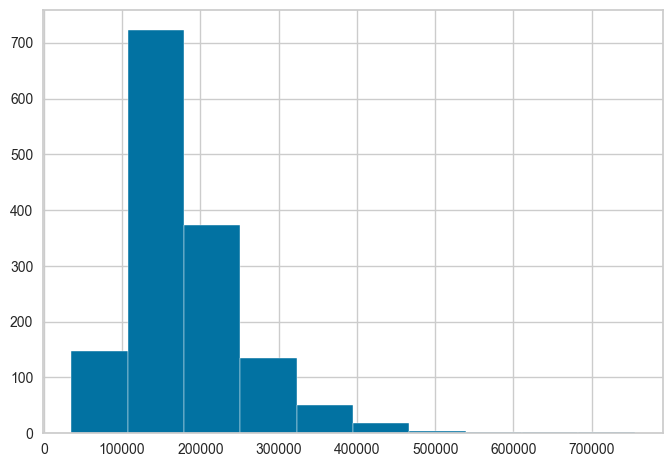

In [41]:
target.hist()

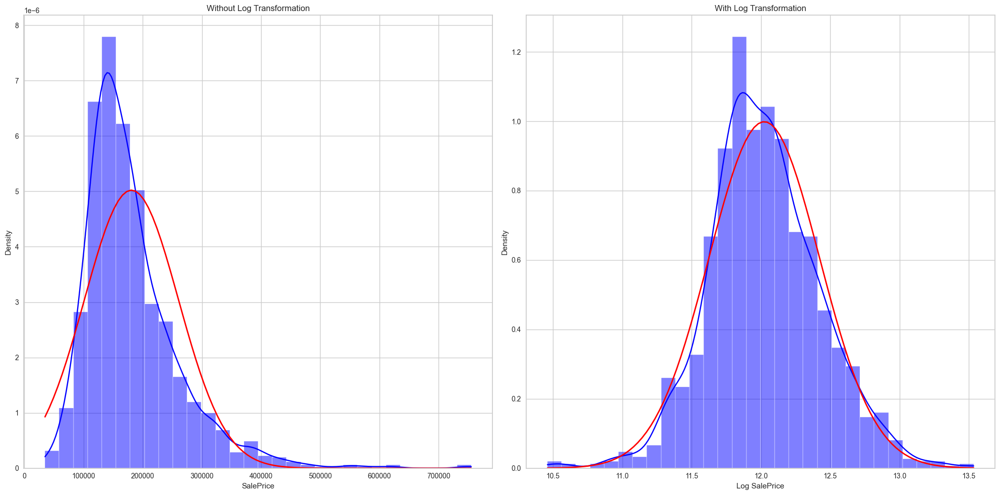

In [42]:
# Create a figure with a specified size (20x10 inches)
plt.figure(figsize=(20,10))

# Create the first subplot (1 row, 2 columns, first subplot)
plt.subplot(1,2,1)

# Plot a histogram of the target variable with KDE (Kernel Density Estimation), density as stat, 30 bins, and blue color
sns.histplot(target, kde=True, stat="density", bins=30, color="blue")

# Generate 100 evenly spaced values between the minimum and maximum of the target variable
x_vals = np.linspace(target.min(), target.max(), 100)

# Calculate the normal probability density function (PDF) using the mean and standard deviation of the target
y_vals = scipy.stats.norm.pdf(x_vals, target.mean(), target.std())

# Plot the normal distribution curve on top of the histogram in red with a line width of 2
plt.plot(x_vals, y_vals, color="red", lw=2)

# Set the title for the first subplot (without log transformation)
plt.title("Without Log Transformation")



# Create the second subplot (1 row, 2 columns, second subplot)
plt.subplot(1,2,2)

# Apply a log transformation (log + 1) to the target variable to avoid taking the log of zero
log_target = np.log(target+1)

# Plot a histogram of the log-transformed target with KDE, density as stat, 30 bins, and blue color
sns.histplot(log_target, kde=True, stat="density", bins=30, color="blue")

# Generate 100 evenly spaced values between the minimum and maximum of the log-transformed target
x_vals = np.linspace(log_target.min(), log_target.max(), 100)

# Calculate the normal PDF for the log-transformed data
y_vals = scipy.stats.norm.pdf(x_vals, log_target.mean(), log_target.std())

# Plot the normal distribution curve on top of the log-transformed histogram in red with a line width of 2
plt.plot(x_vals, y_vals, color="red", lw=2)

# Set the x-axis label for the second subplot (Log-transformed sale price)
plt.xlabel("Log SalePrice")

# Set the title for the second subplot (with log transformation)
plt.title("With Log Transformation")

# Adjust the layout to ensure that subplots do not overlap
plt.tight_layout()

# Display the figure
plt.show()

In [43]:
log_target = np.log(target)

In [44]:
# view the log target
log_target

0       12.247694
1       12.109011
2       12.317167
3       11.849398
4       12.429216
          ...    
1455    12.072541
1456    12.254863
1457    12.493130
1458    11.864462
1459    11.901583
Name: SalePrice, Length: 1460, dtype: float64

In [45]:
# Apply the exponential function to get the original target
np.exp(log_target)

0       208500.0
1       181500.0
2       223500.0
3       140000.0
4       250000.0
          ...   
1455    175000.0
1456    210000.0
1457    266500.0
1458    142125.0
1459    147500.0
Name: SalePrice, Length: 1460, dtype: float64

### Split Data

In [46]:
train_final = data8.loc[:train0.index.max(), :].copy()
test_final = data8.loc[train0.index.max() + 1:, :].reset_index(drop=True).copy()

In [47]:
train_final

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SqFtPerRoom,Total_Home_Quality,Total_Bathrooms,HighQualSF,MSSubClass_120,MSSubClass_150,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSSubClass_20,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,Alley_Grvl,Alley_None,Alley_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_AllPub,Utilities_NoSeWa,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functio

In [48]:
test_final

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SqFtPerRoom,Total_Home_Quality,Total_Bathrooms,HighQualSF,MSSubClass_120,MSSubClass_150,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSSubClass_20,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,Alley_Grvl,Alley_None,Alley_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_AllPub,Utilities_NoSeWa,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functio

### Model Selection

In [49]:
_ = setup(data=pd.concat([train_final, log_target], axis=1), target="SalePrice")

,Description,Value
0,Session id,1096
1,Target,SalePrice
2,Target type,Regression
3,Original data shape,"(1460, 322)"
4,Transformed data shape,"(1460, 322)"
5,Transformed train set shape,"(1021, 322)"
6,Transformed test set shape,"(439, 322)"
7,Numeric features,321
8,Preprocess,True
9,Imputation type,simple


In [50]:
compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,0.0803,0.0159,0.1236,0.9055,0.0096,0.0067,2.1280
br,Bayesian Ridge,0.0859,0.0180,0.1315,0.8929,0.0102,0.0072,0.0820
gbr,Gradient Boosting Regressor,0.0909,0.0195,0.1368,0.8849,0.0106,0.0076,0.2610
lightgbm,Light Gradient Boosting Machine,0.0936,0.0198,0.1394,0.8808,0.0108,0.0079,0.4570
omp,Orthogonal Matching Pursuit,0.0926,0.0206,0.1413,0.8772,0.0109,0.0078,0.0320
et,Extra Trees Regressor,0.0985,0.0220,0.1456,0.8708,0.0113,0.0082,0.5190
rf,Random Forest Regressor,0.0989,0.0227,0.1485,0.8656,0.0115,0.0083,0.4700
xgboost,Extreme Gradient Boosting,0.1012,0.0233,0.1503,0.8620,0.0117,0.0085,0.2740
ada,AdaBoost Regressor,0.1360,0.0327,0.1793,0.8032,0.0139,0.0113,0.2000
knn,K Neighbors Regressor,0.1458,0.0413,0.2010,0.7544,0.0156,0.0122,0.0360


### Baseline Model

In [51]:
baseline_model = CatBoostRegressor(verbose=0)

In [52]:
baseline_model.fit(train_final, log_target)

In [53]:
# Evaluate the baseline model

kf = KFold(n_splits=10)

results = cross_val_score(baseline_model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)

In [54]:
-results

array([0.01303079, 0.00872703, 0.01080219, 0.02290718, 0.02058943,
       0.01082806, 0.01344779, 0.00931941, 0.01353249, 0.01615045])

In [55]:
np.exp(np.sqrt(np.mean(-results)))

1.1252893114851492

In [56]:
target.describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

### Hyperparameter Optimization

In [ ]:
# 1

# Define the objective function for CatBoost using the simplified params
def catboost_objective(trial):
    # Hyperparameters to optimize
    catboost_params = {
        'iterations': trial.suggest_int('iterations', 100, 1000),  # Number of boosting iterations
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-3, 0.3),  # Learning rate
        'depth': trial.suggest_int('depth', 4, 10),  # Depth of the tree
        'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 1e-3, 10),  # L2 regularization
        'eval_metric': 'RMSE',  # Evaluation metric
        'early_stopping_rounds': trial.suggest_int('early_stopping_rounds', 10, 200),  # Early stopping rounds
        'random_seed': 42  # Random seed for reproducibility
    }
    
    # Initialize the CatBoost model with suggested parameters
    model = CatBoostRegressor(
        iterations=catboost_params['iterations'],
        learning_rate=catboost_params['learning_rate'],
        depth=catboost_params['depth'],
        l2_leaf_reg=catboost_params['l2_leaf_reg'],
        eval_metric=catboost_params['eval_metric'],
        early_stopping_rounds=catboost_params['early_stopping_rounds'],
        random_seed=catboost_params['random_seed'],
        verbose=0  # Suppress the output during training
    )
    
    # Cross-validation
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)

    # Return the mean of the negative MSE (because we want to minimize it)
    return np.mean(cv_score)

# Create and optimize the study
study = optuna.create_study(direction="maximize")
study.optimize(catboost_objective, n_trials=100)

[I 2024-12-16 19:53:55,796] A new study created in memory with name: no-name-a3a7a03c-d7fd-4460-b920-87a4d1fad292
[I 2024-12-16 19:54:07,908] Trial 0 finished with value: -0.08154991874487941 and parameters: {'iterations': 453, 'learning_rate': 0.001194111618646685, 'depth': 7, 'l2_leaf_reg': 0.015437438173535956, 'early_stopping_rounds': 180}. Best is trial 0 with value: -0.08154991874487941.
[I 2024-12-16 19:55:14,029] Trial 1 finished with value: -0.017152370141920927 and parameters: {'iterations': 852, 'learning_rate': 0.011881823746061835, 'depth': 9, 'l2_leaf_reg': 0.0034652461232753274, 'early_stopping_rounds': 157}. Best is trial 1 with value: -0.017152370141920927.
[I 2024-12-16 19:55:22,069] Trial 2 finished with value: -0.015514124286599384 and parameters: {'iterations': 914, 'learning_rate': 0.025142401610635162, 'depth': 5, 'l2_leaf_reg': 1.0247591982305493, 'early_stopping_rounds': 144}. Best is trial 2 with value: -0.015514124286599384.
[I 2024-12-16 19:55:45,610] Trial 

In [80]:
# Output the best parameters found
study.best_params

{'iterations': 882,
 'learning_rate': 0.06637555401780555,
 'depth': 6,
 'l2_leaf_reg': 3.2782718865207894,
 'early_stopping_rounds': 170}

In [ ]:
# 2

def gbr_objective(trial):
    n_estimators = trial.suggest_int("n_estimators", 50, 500)
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1.0)
    max_depth = trial.suggest_int("max_depth", 3, 10)
    min_samples_split = trial.suggest_int("min_samples_split", 2, 20)
    min_samples_leaf = trial.suggest_int("min_samples_leaf", 1, 20)
    subsample = trial.suggest_uniform("subsample", 0.5, 1.0)
    max_features = trial.suggest_uniform("max_features", 0.1, 1.0)

    model = GradientBoostingRegressor(
        n_estimators=n_estimators,
        learning_rate=learning_rate,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        subsample=subsample,
        max_features=max_features
    )

    model.fit(train_final, log_target)

    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)
    
    return np.mean(cv_score)

study = optuna.create_study(direction="minimize")
study.optimize(gbr_objective, n_trials=100)

[I 2024-12-16 22:21:51,682] A new study created in memory with name: no-name-6b89f3de-15d5-4530-b1cc-a81a298c3a90
[I 2024-12-16 22:22:25,993] Trial 0 finished with value: -0.015559584058873654 and parameters: {'n_estimators': 446, 'learning_rate': 0.13829020787372823, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 4, 'subsample': 0.7734465626661851, 'max_features': 0.6315519728828212}. Best is trial 0 with value: -0.015559584058873654.
[I 2024-12-16 22:23:07,988] Trial 1 finished with value: -0.01536548436999989 and parameters: {'n_estimators': 377, 'learning_rate': 0.08049846241689514, 'max_depth': 7, 'min_samples_split': 15, 'min_samples_leaf': 3, 'subsample': 0.7676215602290708, 'max_features': 0.5471691714441258}. Best is trial 0 with value: -0.015559584058873654.
[I 2024-12-16 22:23:20,618] Trial 2 finished with value: -0.14827936429772368 and parameters: {'n_estimators': 222, 'learning_rate': 0.00020387115875397915, 'max_depth': 9, 'min_samples_split': 7, 'min_sampl

In [82]:
# Output the best parameters found
study.best_params

{'n_estimators': 65,
 'learning_rate': 0.00010159354228065319,
 'max_depth': 4,
 'min_samples_split': 11,
 'min_samples_leaf': 14,
 'subsample': 0.8497654426347608,
 'max_features': 0.8343659161609325}

In [ ]:
# 3

# Objective function for hyperparameter optimization for BayesianRidge

def br_objective(trial):
    # Hyperparameters to optimize
    n_iter = trial.suggest_int("n_iter", 50,600)
    tol = trial.suggest_loguniform("tol", 1e-8, 10.0)
    alpha_1 = trial.suggest_loguniform("alpha_1", 1e-8, 10.0)
    alpha_2 = trial.suggest_loguniform("alpha_2", 1e-8, 10.0)
    lambda_1 = trial.suggest_loguniform("lambda_1", 1e-8, 10.0)
    lambda_2 = trial.suggest_loguniform("lambda_2", 1e-8, 10.0)

    # Create a BayesianRidge model using the suggested hyperparameters
    model = BayesianRidge(
        n_iter = n_iter,
        tol = tol,
        alpha_1 = alpha_1,
        alpha_2 = alpha_2,
        lambda_1 = lambda_1,
        lambda_2 = lambda_2
    )

    model.fit(train_final, log_target)

    # Perform cross-validation and return the mean negative MSE    
    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)
    
    return np.mean(cv_score)

# Create an Optuna study with the objective to minimize the value (negative MSE)
study = optuna.create_study(direction = "minimize")
study.optimize(br_objective, n_trials=100)

[I 2024-12-16 22:52:07,613] A new study created in memory with name: no-name-6f8da0ec-6966-4437-a4fa-825b5c29155f
[I 2024-12-16 22:52:14,848] Trial 0 finished with value: -0.017272563098960723 and parameters: {'n_iter': 54, 'tol': 1.3719490686797431e-08, 'alpha_1': 0.00012325762768149602, 'alpha_2': 4.030136978420683e-08, 'lambda_1': 1.0735783792795612e-08, 'lambda_2': 9.47461372888391e-07}. Best is trial 0 with value: -0.017272563098960723.
[I 2024-12-16 22:52:22,479] Trial 1 finished with value: -0.016931117503109928 and parameters: {'n_iter': 498, 'tol': 3.689662239671913e-08, 'alpha_1': 2.2952396473375623e-07, 'alpha_2': 2.5722404526859255, 'lambda_1': 4.313765182771007e-08, 'lambda_2': 0.00020681453431321175}. Best is trial 0 with value: -0.017272563098960723.
[I 2024-12-16 22:52:29,468] Trial 2 finished with value: -0.017257898339701976 and parameters: {'n_iter': 478, 'tol': 0.21290859559059558, 'alpha_1': 0.005362133398280528, 'alpha_2': 0.11039523414600218, 'lambda_1': 0.013639

In [84]:
# Output the best parameters found
study.best_params

{'n_iter': 237,
 'tol': 0.027806416001001418,
 'alpha_1': 1.881952929334799e-08,
 'alpha_2': 0.000907964629324288,
 'lambda_1': 0.007445915026845865,
 'lambda_2': 9.967266505685522}

In [93]:
# 4

def lgbm_objective(trial):
    n_estimators = trial.suggest_int("n_estimators", 50, 500)
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-4, 1.0)
    max_depth = trial.suggest_int("max_depth", 3, 10)
    num_leaves = trial.suggest_int("num_leaves", 20, 150)
    min_data_in_leaf = trial.suggest_int("min_data_in_leaf", 1, 100)
    lambda_l1 = trial.suggest_loguniform("lambda_l1", 1e-4, 10.0)
    lambda_l2 = trial.suggest_loguniform("lambda_l2", 1e-4, 10.0)
    feature_fraction = trial.suggest_uniform("feature_fraction", 0.1, 1.0)
    bagging_fraction = trial.suggest_uniform("bagging_fraction", 0.1, 1.0)
    bagging_freq = trial.suggest_int("bagging_freq", 1, 10)

    model = LGBMRegressor(
        n_estimators=n_estimators,
        learning_rate=learning_rate,
        max_depth=max_depth,
        num_leaves=num_leaves,
        min_data_in_leaf=min_data_in_leaf,
        lambda_l1=lambda_l1,
        lambda_l2=lambda_l2,
        feature_fraction=feature_fraction,
        bagging_fraction=bagging_fraction,
        bagging_freq=bagging_freq
    )

    model.fit(train_final, log_target)

    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)
    
    return np.mean(cv_score)

study = optuna.create_study(direction="minimize")
study.optimize(lgbm_objective, n_trials=100)

[I 2024-12-17 02:07:00,233] A new study created in memory with name: no-name-03e7c4b8-d6e1-4af3-b6f1-7b52c5792695


[LightGBM] [Warning] lambda_l1 is set=0.03205236559948985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03205236559948985
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9111665784209901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9111665784209901
[LightGBM] [Warning] bagging_fraction is set=0.9646142500285512, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646142500285512
[LightGBM] [Warning] lambda_l2 is set=0.003299560222643903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003299560222643903
[LightGBM] [Warning] min_data_in_leaf is set=78, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=78
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.03205236559948985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0

[I 2024-12-17 02:07:10,144] Trial 0 finished with value: -0.032217470501585424 and parameters: {'n_estimators': 450, 'learning_rate': 0.003734282303390506, 'max_depth': 6, 'num_leaves': 23, 'min_data_in_leaf': 78, 'lambda_l1': 0.03205236559948985, 'lambda_l2': 0.003299560222643903, 'feature_fraction': 0.9111665784209901, 'bagging_fraction': 0.9646142500285512, 'bagging_freq': 2}. Best is trial 0 with value: -0.032217470501585424.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:17,108] Trial 1 finished with value: -0.141894639324894 and parameters: {'n_estimators': 371, 'learning_rate': 0.00026755147018085463, 'max_depth': 7, 'num_leaves': 57, 'min_data_in_leaf': 39, 'lambda_l1': 0.729824948127855, 'lambda_l2': 0.028115172454234384, 'feature_fraction': 0.20059530800216424, 'bagging_fraction': 0.39573464803728287, 'bagging_freq': 4}. Best is trial 1 with value: -0.141894639324894.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:22,830] Trial 2 finished with value: -0.023309007054312443 and parameters: {'n_estimators': 383, 'learning_rate': 0.007814216627102728, 'max_depth': 4, 'num_leaves': 123, 'min_data_in_leaf': 64, 'lambda_l1': 0.47540456639852247, 'lambda_l2': 0.0005098374443845732, 'feature_fraction': 0.7395425288843909, 'bagging_fraction': 0.6539614837197607, 'bagging_freq': 10}. Best is trial 1 with value: -0.141894639324894.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:26,374] Trial 3 finished with value: -0.15252881996509887 and parameters: {'n_estimators': 167, 'learning_rate': 0.00020215581424799426, 'max_depth': 7, 'num_leaves': 42, 'min_data_in_leaf': 97, 'lambda_l1': 0.01784252956676406, 'lambda_l2': 0.004246496707916896, 'feature_fraction': 0.6979791740917102, 'bagging_fraction': 0.8557983207394234, 'bagging_freq': 9}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:27,410] Trial 4 finished with value: -0.1021273150777859 and parameters: {'n_estimators': 51, 'learning_rate': 0.007856337400668729, 'max_depth': 3, 'num_leaves': 116, 'min_data_in_leaf': 97, 'lambda_l1': 1.3534519216864753, 'lambda_l2': 0.7098597974999281, 'feature_fraction': 0.39524554179760374, 'bagging_fraction': 0.6399665718976132, 'bagging_freq': 1}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lamb

[I 2024-12-17 02:07:29,604] Trial 5 finished with value: -0.14973128327102606 and parameters: {'n_estimators': 139, 'learning_rate': 0.0003774500869307863, 'max_depth': 3, 'num_leaves': 143, 'min_data_in_leaf': 96, 'lambda_l1': 0.04056686065919901, 'lambda_l2': 0.00012660060954982485, 'feature_fraction': 0.2827466960002557, 'bagging_fraction': 0.830997633123596, 'bagging_freq': 4}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:38,632] Trial 6 finished with value: -0.1407473576857573 and parameters: {'n_estimators': 421, 'learning_rate': 0.00024046014929285554, 'max_depth': 8, 'num_leaves': 125, 'min_data_in_leaf': 99, 'lambda_l1': 0.07060043148855143, 'lambda_l2': 0.00012838511250253063, 'feature_fraction': 0.2414119441216989, 'bagging_fraction': 0.9371700160250933, 'bagging_freq': 10}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] lambda_l1 is set=0.07060043148855143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07060043148855143
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.2414119441216989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2414119441216989
[LightGBM] [Warning] bagging_fraction is set=0.9371700160250933, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9371700160250933
[LightGBM] [Warning] lambda_l2 is set=0.00012838511250253063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012838511250253063
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] lambda_l1 is set=0.03880138097940199, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03880138097940199
[LightGBM] [Warning] bagging_freq is set=4, subsample_f

[I 2024-12-17 02:07:39,520] Trial 7 finished with value: -0.023815118681901094 and parameters: {'n_estimators': 89, 'learning_rate': 0.20539993063533352, 'max_depth': 7, 'num_leaves': 34, 'min_data_in_leaf': 81, 'lambda_l1': 0.03880138097940199, 'lambda_l2': 0.00010652100468221596, 'feature_fraction': 0.98011658814281, 'bagging_fraction': 0.2815030576655829, 'bagging_freq': 4}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.03880138097940199, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03880138097940199
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.98011658814281, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98011658814281
[LightGBM] [Warning] bagging_fraction is set=0.2815030576655829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2815030576655829
[LightGBM]

[I 2024-12-17 02:07:46,092] Trial 8 finished with value: -0.02162718270746073 and parameters: {'n_estimators': 238, 'learning_rate': 0.012232978655669786, 'max_depth': 5, 'num_leaves': 90, 'min_data_in_leaf': 68, 'lambda_l1': 0.262200043445337, 'lambda_l2': 1.126534150163092, 'feature_fraction': 0.3133124718836793, 'bagging_fraction': 0.9497940395923777, 'bagging_freq': 2}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:07:56,056] Trial 9 finished with value: -0.1448584165384466 and parameters: {'n_estimators': 429, 'learning_rate': 0.00015618510308687615, 'max_depth': 5, 'num_leaves': 62, 'min_data_in_leaf': 15, 'lambda_l1': 0.00033612814984460487, 'lambda_l2': 0.0032713454279649076, 'feature_fraction': 0.704672179996308, 'bagging_fraction': 0.25933461266231356, 'bagging_freq': 10}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:03,862] Trial 10 finished with value: -0.026185196745431395 and parameters: {'n_estimators': 219, 'learning_rate': 0.6033780462056609, 'max_depth': 10, 'num_leaves': 58, 'min_data_in_leaf': 42, 'lambda_l1': 0.000966312345623178, 'lambda_l2': 7.825633671590116, 'feature_fraction': 0.5298441192296142, 'bagging_fraction': 0.7674678031751792, 'bagging_freq': 7}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.000966312345623178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000966312345623178
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5298441192296142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5298441192296142
[LightGBM] [Warning] bagging_fraction is set=0.7674678031751792, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7674678031751792
[Lig

[I 2024-12-17 02:08:07,307] Trial 11 finished with value: -0.12352801435351735 and parameters: {'n_estimators': 159, 'learning_rate': 0.001267360075632261, 'max_depth': 9, 'num_leaves': 146, 'min_data_in_leaf': 99, 'lambda_l1': 0.003302336820011766, 'lambda_l2': 0.003213250981470852, 'feature_fraction': 0.5244390079980337, 'bagging_fraction': 0.76850017790706, 'bagging_freq': 6}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] lambda_l1 is set=0.003302336820011766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003302336820011766
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5244390079980337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5244390079980337
[LightGBM] [Warning] bagging_fraction is set=0.76850017790706, subsample=1.0 will be ignored. Current value: bagging_fraction=0.76850017790706
[LightGBM] [Warning] lambda_l2 is set=0.003213250981470852, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003213250981470852
[LightGBM] [Warning] min_data_in_leaf is set=99, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=99
[LightGBM] [Warning] lambda_l1 is set=0.007745537390783573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007745537390783573
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 

[I 2024-12-17 02:08:09,475] Trial 12 finished with value: -0.1375382242231395 and parameters: {'n_estimators': 147, 'learning_rate': 0.0009462077954464627, 'max_depth': 3, 'num_leaves': 93, 'min_data_in_leaf': 84, 'lambda_l1': 0.007745537390783573, 'lambda_l2': 0.07520316526382426, 'feature_fraction': 0.12784856848499299, 'bagging_fraction': 0.7507997890723833, 'bagging_freq': 7}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:12,218] Trial 13 finished with value: -0.02596679015791496 and parameters: {'n_estimators': 310, 'learning_rate': 0.04312529865992257, 'max_depth': 6, 'num_leaves': 145, 'min_data_in_leaf': 54, 'lambda_l1': 8.422964411248953, 'lambda_l2': 0.0011775927248603483, 'feature_fraction': 0.7352026146531234, 'bagging_fraction': 0.49750854787255866, 'bagging_freq': 8}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

[I 2024-12-17 02:08:13,997] Trial 14 finished with value: -0.1377126729852523 and parameters: {'n_estimators': 148, 'learning_rate': 0.0008968161784407298, 'max_depth': 9, 'num_leaves': 70, 'min_data_in_leaf': 23, 'lambda_l1': 0.0034043057815328426, 'lambda_l2': 0.023957773143979004, 'feature_fraction': 0.43959391398103653, 'bagging_fraction': 0.10402628302712524, 'bagging_freq': 4}. Best is trial 3 with value: -0.15252881996509887.


[LightGBM] [Warning] lambda_l1 is set=0.0034043057815328426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0034043057815328426
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.43959391398103653, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.43959391398103653
[LightGBM] [Warning] bagging_fraction is set=0.10402628302712524, subsample=1.0 will be ignored. Current value: bagging_fraction=0.10402628302712524
[LightGBM] [Warning] lambda_l2 is set=0.023957773143979004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.023957773143979004
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] lambda_l1 is set=0.010641364414733782, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.010641364414733782
[LightGBM] [Warning] bagging_freq is set=5, subsamp

[I 2024-12-17 02:08:17,589] Trial 15 finished with value: -0.1551297315115246 and parameters: {'n_estimators': 196, 'learning_rate': 0.00010613093427993594, 'max_depth': 5, 'num_leaves': 40, 'min_data_in_leaf': 86, 'lambda_l1': 0.010641364414733782, 'lambda_l2': 0.0006974455538981139, 'feature_fraction': 0.6451778043415476, 'bagging_fraction': 0.8588788572180355, 'bagging_freq': 5}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:30,943] Trial 16 finished with value: -0.15185971267796633 and parameters: {'n_estimators': 299, 'learning_rate': 0.00010826938958218111, 'max_depth': 5, 'num_leaves': 39, 'min_data_in_leaf': 3, 'lambda_l1': 0.008329062112553567, 'lambda_l2': 0.0007185326268977965, 'feature_fraction': 0.6536755581109243, 'bagging_fraction': 0.8571315156489419, 'bagging_freq': 8}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.008329062112553567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008329062112553567
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6536755581109243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6536755581109243
[

[I 2024-12-17 02:08:34,107] Trial 17 finished with value: -0.08080441956090736 and parameters: {'n_estimators': 205, 'learning_rate': 0.0027026097253952355, 'max_depth': 8, 'num_leaves': 40, 'min_data_in_leaf': 67, 'lambda_l1': 0.0001646109912513615, 'lambda_l2': 0.009151292290196966, 'feature_fraction': 0.8324489237369382, 'bagging_fraction': 0.5874185246299479, 'bagging_freq': 6}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:35,654] Trial 18 finished with value: -0.14872237435864744 and parameters: {'n_estimators': 95, 'learning_rate': 0.0005593693963767041, 'max_depth': 6, 'num_leaves': 76, 'min_data_in_leaf': 85, 'lambda_l1': 0.14803242293697455, 'lambda_l2': 0.010480795341188327, 'feature_fraction': 0.8228344446569844, 'bagging_fraction': 0.6993762129974188, 'bagging_freq': 8}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:39,038] Trial 19 finished with value: -0.017808880222743205 and parameters: {'n_estimators': 266, 'learning_rate': 0.050831932174978584, 'max_depth': 4, 'num_leaves': 23, 'min_data_in_leaf': 55, 'lambda_l1': 0.009948485668570088, 'lambda_l2': 0.12686820483840483, 'feature_fraction': 0.6223215740036321, 'bagging_fraction': 0.4885176075159855, 'bagging_freq': 5}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:08:49,864] Trial 20 finished with value: -0.14820002523849102 and parameters: {'n_estimators': 497, 'learning_rate': 0.00010744372274436279, 'max_depth': 8, 'num_leaves': 41, 'min_data_in_leaf': 76, 'lambda_l1': 0.0008311911997642694, 'lambda_l2': 0.00040350489046000765, 'feature_fraction': 0.5728842198905664, 'bagging_fraction': 0.8735488072867056, 'bagging_freq': 9}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:01,066] Trial 21 finished with value: -0.15196646420562043 and parameters: {'n_estimators': 315, 'learning_rate': 0.0001023900542556609, 'max_depth': 5, 'num_leaves': 47, 'min_data_in_leaf': 26, 'lambda_l1': 0.010277437589613577, 'lambda_l2': 0.0006722653074317809, 'feature_fraction': 0.6379618766944072, 'bagging_fraction': 0.8781347650742714, 'bagging_freq': 8}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:09,857] Trial 22 finished with value: -0.13500243731318548 and parameters: {'n_estimators': 330, 'learning_rate': 0.0003564192492170211, 'max_depth': 4, 'num_leaves': 49, 'min_data_in_leaf': 31, 'lambda_l1': 0.01689403958769456, 'lambda_l2': 0.0015154646272465067, 'feature_fraction': 0.4697186990557016, 'bagging_fraction': 0.9976699944455899, 'bagging_freq': 9}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.01689403958769456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01689403958769456
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.4697186990557016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4697186990557016
[LightGBM] [Warning] bagging_fraction is set=0.9976699944455899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9976699944455899
[LightGBM] [Warning] lambda_l2 is set=0.0015154646272465067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015154646272465067
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] lambda_l1 is set=0.0029382206939281104, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.

[I 2024-12-17 02:09:14,141] Trial 23 finished with value: -0.1539372377772083 and parameters: {'n_estimators': 254, 'learning_rate': 0.00010343674390233406, 'max_depth': 5, 'num_leaves': 21, 'min_data_in_leaf': 89, 'lambda_l1': 0.0029382206939281104, 'lambda_l2': 0.00028742424213120104, 'feature_fraction': 0.7982264134418885, 'bagging_fraction': 0.8703495203972498, 'bagging_freq': 7}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:17,359] Trial 24 finished with value: -0.1030520978965298 and parameters: {'n_estimators': 189, 'learning_rate': 0.00181438081217409, 'max_depth': 7, 'num_leaves': 21, 'min_data_in_leaf': 90, 'lambda_l1': 0.0023428729332453896, 'lambda_l2': 0.0002254256222436681, 'feature_fraction': 0.8268825176814266, 'bagging_fraction': 0.8137037729096013, 'bagging_freq': 5}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:20,656] Trial 25 finished with value: -0.13293859103310784 and parameters: {'n_estimators': 243, 'learning_rate': 0.0005734233379487844, 'max_depth': 6, 'num_leaves': 28, 'min_data_in_leaf': 90, 'lambda_l1': 0.0006017287115431479, 'lambda_l2': 0.0018547772734502739, 'feature_fraction': 0.7859155471635315, 'bagging_fraction': 0.6932677796486104, 'bagging_freq': 7}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:24,535] Trial 26 finished with value: -0.15074556127106614 and parameters: {'n_estimators': 189, 'learning_rate': 0.00021336039100259136, 'max_depth': 4, 'num_leaves': 32, 'min_data_in_leaf': 73, 'lambda_l1': 0.11260862869604547, 'lambda_l2': 0.008611885246041385, 'feature_fraction': 0.9325094646124665, 'bagging_fraction': 0.8934297714706082, 'bagging_freq': 6}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:27,506] Trial 27 finished with value: -0.1490598282449001 and parameters: {'n_estimators': 273, 'learning_rate': 0.00019265652635057105, 'max_depth': 5, 'num_leaves': 80, 'min_data_in_leaf': 91, 'lambda_l1': 0.0016886077355301298, 'lambda_l2': 0.00028751629746546353, 'feature_fraction': 0.8904973355332194, 'bagging_fraction': 0.5761765216992325, 'bagging_freq': 9}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:30,093] Trial 28 finished with value: -0.14877629471622558 and parameters: {'n_estimators': 99, 'learning_rate': 0.0004946469903813729, 'max_depth': 7, 'num_leaves': 51, 'min_data_in_leaf': 58, 'lambda_l1': 0.02085132068374792, 'lambda_l2': 0.004978074729550843, 'feature_fraction': 0.6757787696508272, 'bagging_fraction': 0.8009646501462995, 'bagging_freq': 3}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.02085132068374792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02085132068374792
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6757787696508272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6757787696508272
[Li

[I 2024-12-17 02:09:34,065] Trial 29 finished with value: -0.0866408344174043 and parameters: {'n_estimators': 182, 'learning_rate': 0.002571163279151468, 'max_depth': 6, 'num_leaves': 101, 'min_data_in_leaf': 76, 'lambda_l1': 0.003643964032669032, 'lambda_l2': 0.0012408635862592868, 'feature_fraction': 0.8926445714555835, 'bagging_fraction': 0.9445627585494937, 'bagging_freq': 7}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:38,161] Trial 30 finished with value: -0.02067453351078501 and parameters: {'n_estimators': 237, 'learning_rate': 0.018955189185833225, 'max_depth': 6, 'num_leaves': 68, 'min_data_in_leaf': 86, 'lambda_l1': 0.0001620296676657842, 'lambda_l2': 0.00024510913316758533, 'feature_fraction': 0.6044778621607132, 'bagging_fraction': 0.7140667613735576, 'bagging_freq': 5}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:09:48,251] Trial 31 finished with value: -0.1486297289277893 and parameters: {'n_estimators': 357, 'learning_rate': 0.00013352328457199995, 'max_depth': 5, 'num_leaves': 47, 'min_data_in_leaf': 42, 'lambda_l1': 0.006737434201922074, 'lambda_l2': 0.000610186701990605, 'feature_fraction': 0.771567774407024, 'bagging_fraction': 0.8981640739717645, 'bagging_freq': 8}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:02,112] Trial 32 finished with value: -0.15114724943835997 and parameters: {'n_estimators': 335, 'learning_rate': 0.00010545744573735645, 'max_depth': 5, 'num_leaves': 29, 'min_data_in_leaf': 10, 'lambda_l1': 0.013789867185844573, 'lambda_l2': 0.0008355456976730268, 'feature_fraction': 0.6743803296789794, 'bagging_fraction': 0.9901782776132837, 'bagging_freq': 9}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] lambda_l1 is set=0.013789867185844573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.013789867185844573
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6743803296789794, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6743803296789794
[LightGBM] [Warning] bagging_fraction is set=0.9901782776132837, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9901782776132837
[LightGBM] [Warning] lambda_l2 is set=0.0008355456976730268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008355456976730268
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] lambda_l1 is set=0.038960734761831574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.038960734761831574
[LightGBM] [Warning] bagging_freq is set=8, subsample_f

[I 2024-12-17 02:10:09,832] Trial 33 finished with value: -0.14339845512130195 and parameters: {'n_estimators': 297, 'learning_rate': 0.0002496182824079529, 'max_depth': 4, 'num_leaves': 46, 'min_data_in_leaf': 34, 'lambda_l1': 0.038960734761831574, 'lambda_l2': 0.0025903470426148056, 'feature_fraction': 0.5730237260936499, 'bagging_fraction': 0.8963210586233618, 'bagging_freq': 8}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.038960734761831574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.038960734761831574
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5730237260936499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5730237260936499
[LightGBM] [Warning] bagging_fraction is set=0.8963210586233618, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8963210586233618
[Lig

[I 2024-12-17 02:10:23,835] Trial 34 finished with value: -0.1427083397949322 and parameters: {'n_estimators': 264, 'learning_rate': 0.00027059048320253676, 'max_depth': 7, 'num_leaves': 55, 'min_data_in_leaf': 23, 'lambda_l1': 0.005216305603023712, 'lambda_l2': 0.00044277502583104126, 'feature_fraction': 0.741629245716646, 'bagging_fraction': 0.8439575007935628, 'bagging_freq': 6}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:28,823] Trial 35 finished with value: -0.128446322405476 and parameters: {'n_estimators': 398, 'learning_rate': 0.0004279031904951982, 'max_depth': 4, 'num_leaves': 20, 'min_data_in_leaf': 94, 'lambda_l1': 0.0014846925677059843, 'lambda_l2': 0.019213736555322644, 'feature_fraction': 0.6421773577411239, 'bagging_fraction': 0.6640915984989043, 'bagging_freq': 7}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:35,201] Trial 36 finished with value: -0.0517544904214402 and parameters: {'n_estimators': 222, 'learning_rate': 0.004217067317109409, 'max_depth': 5, 'num_leaves': 34, 'min_data_in_leaf': 48, 'lambda_l1': 0.07191564725391095, 'lambda_l2': 0.05929183044910957, 'feature_fraction': 0.48162718916629177, 'bagging_fraction': 0.7804382620250347, 'bagging_freq': 10}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:38,256] Trial 37 finished with value: -0.1547110032740155 and parameters: {'n_estimators': 119, 'learning_rate': 0.00018157769856510562, 'max_depth': 6, 'num_leaves': 42, 'min_data_in_leaf': 63, 'lambda_l1': 0.03137185451599709, 'lambda_l2': 0.0002006109366858412, 'feature_fraction': 0.6995230034185937, 'bagging_fraction': 0.9210570694678414, 'bagging_freq': 9}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:41,710] Trial 38 finished with value: -0.15424136951216197 and parameters: {'n_estimators': 132, 'learning_rate': 0.00018231001944655077, 'max_depth': 6, 'num_leaves': 62, 'min_data_in_leaf': 64, 'lambda_l1': 0.6645854730731778, 'lambda_l2': 0.00016580403474974773, 'feature_fraction': 0.707207486283734, 'bagging_fraction': 0.9342043381784879, 'bagging_freq': 3}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:45,053] Trial 39 finished with value: -0.14032731059228942 and parameters: {'n_estimators': 122, 'learning_rate': 0.0007476648864511634, 'max_depth': 6, 'num_leaves': 59, 'min_data_in_leaf': 59, 'lambda_l1': 0.8915215282123172, 'lambda_l2': 0.00017939065751230692, 'feature_fraction': 0.7183019224193199, 'bagging_fraction': 0.9322664560390205, 'bagging_freq': 3}. Best is trial 15 with value: -0.1551297315115246.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.8915215282123172, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8915215282123172
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7183019224193199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7183019224193199
[LightGBM] [Warning] bagging_fraction is set=0.9322664560390205, subsample=1.0 w

[I 2024-12-17 02:10:46,596] Trial 40 finished with value: -0.1560325019668598 and parameters: {'n_estimators': 53, 'learning_rate': 0.0003209603031188775, 'max_depth': 6, 'num_leaves': 64, 'min_data_in_leaf': 63, 'lambda_l1': 3.13761940061721, 'lambda_l2': 0.00010436404191466352, 'feature_fraction': 0.7832454598805147, 'bagging_fraction': 0.9590614740076611, 'bagging_freq': 1}. Best is trial 40 with value: -0.1560325019668598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=3.13761940061721, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.13761940061721
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [W

[I 2024-12-17 02:10:48,129] Trial 41 finished with value: -0.15609401043034177 and parameters: {'n_estimators': 52, 'learning_rate': 0.0003146713561102441, 'max_depth': 6, 'num_leaves': 61, 'min_data_in_leaf': 63, 'lambda_l1': 2.3213586548209024, 'lambda_l2': 0.00010584656248155633, 'feature_fraction': 0.783241870307343, 'bagging_fraction': 0.9592927117155422, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:49,691] Trial 42 finished with value: -0.15595246916422756 and parameters: {'n_estimators': 54, 'learning_rate': 0.0003205959654668938, 'max_depth': 6, 'num_leaves': 67, 'min_data_in_leaf': 62, 'lambda_l1': 2.951879284156252, 'lambda_l2': 0.00011051503739152633, 'feature_fraction': 0.7545383443722385, 'bagging_fraction': 0.965681973971667, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:51,460] Trial 43 finished with value: -0.15544951378360322 and parameters: {'n_estimators': 65, 'learning_rate': 0.00030334045520972477, 'max_depth': 7, 'num_leaves': 70, 'min_data_in_leaf': 71, 'lambda_l1': 3.1091567182584776, 'lambda_l2': 0.00010294858316754154, 'feature_fraction': 0.8589960115195484, 'bagging_fraction': 0.9963753462909605, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:52,829] Trial 44 finished with value: -0.144398457609037 and parameters: {'n_estimators': 51, 'learning_rate': 0.0015329337868427947, 'max_depth': 7, 'num_leaves': 69, 'min_data_in_leaf': 68, 'lambda_l1': 4.213248139630317, 'lambda_l2': 0.00015841779409587342, 'feature_fraction': 0.8627967439884026, 'bagging_fraction': 0.9792794635225397, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=4.213248139630317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.213248139630317
[LightGBM] [Warning] bagging_freq is set=1, 

[I 2024-12-17 02:10:54,921] Trial 45 finished with value: -0.1549609870012743 and parameters: {'n_estimators': 66, 'learning_rate': 0.00032433814337003657, 'max_depth': 7, 'num_leaves': 79, 'min_data_in_leaf': 49, 'lambda_l1': 2.2394356264644424, 'lambda_l2': 0.00011140756331973973, 'feature_fraction': 0.9512734564672395, 'bagging_fraction': 0.9979756551590987, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:10:56,839] Trial 46 finished with value: -0.14813224399110805 and parameters: {'n_estimators': 69, 'learning_rate': 0.0007897382676003969, 'max_depth': 8, 'num_leaves': 91, 'min_data_in_leaf': 72, 'lambda_l1': 2.176081049114548, 'lambda_l2': 0.0001151558365781081, 'feature_fraction': 0.9846812608190192, 'bagging_fraction': 0.9576788590303621, 'bagging_freq': 2}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=2.176081049114548, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.176081049114548
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] 

[I 2024-12-17 02:10:58,674] Trial 47 finished with value: -0.1429373292274393 and parameters: {'n_estimators': 73, 'learning_rate': 0.0012227075438435463, 'max_depth': 7, 'num_leaves': 66, 'min_data_in_leaf': 79, 'lambda_l1': 5.086063690179215, 'lambda_l2': 0.00010042393117258141, 'feature_fraction': 0.7597328765206606, 'bagging_fraction': 0.9624681725808231, 'bagging_freq': 2}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:00,233] Trial 48 finished with value: -0.04639387510865271 and parameters: {'n_estimators': 107, 'learning_rate': 0.920148584142441, 'max_depth': 6, 'num_leaves': 74, 'min_data_in_leaf': 72, 'lambda_l1': 0.35259043448836, 'lambda_l2': 0.00041118117726035965, 'feature_fraction': 0.8406615299759103, 'bagging_fraction': 0.371436382125637, 'bagging_freq': 1}. Best is trial 41 with value: -0.15609401043034177.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:01,507] Trial 49 finished with value: -0.15613886348845968 and parameters: {'n_estimators': 52, 'learning_rate': 0.0003646467026625597, 'max_depth': 8, 'num_leaves': 84, 'min_data_in_leaf': 60, 'lambda_l1': 8.551273987999902, 'lambda_l2': 0.00033682986036233647, 'feature_fraction': 0.8793574398081806, 'bagging_fraction': 0.8339277577081956, 'bagging_freq': 2}. Best is trial 49 with value: -0.15613886348845968.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3927
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 137
[LightGBM] [Info] Start training from score 12.027127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

[I 2024-12-17 02:11:03,600] Trial 50 finished with value: -0.09701737446201006 and parameters: {'n_estimators': 79, 'learning_rate': 0.004946806145508512, 'max_depth': 8, 'num_leaves': 102, 'min_data_in_leaf': 62, 'lambda_l1': 1.620529400262379, 'lambda_l2': 0.3629122831020919, 'feature_fraction': 0.8723181753226213, 'bagging_fraction': 0.829158530028635, 'bagging_freq': 2}. Best is trial 49 with value: -0.15613886348845968.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:04,995] Trial 51 finished with value: -0.1561860560303201 and parameters: {'n_estimators': 54, 'learning_rate': 0.0003463852391667785, 'max_depth': 9, 'num_leaves': 84, 'min_data_in_leaf': 53, 'lambda_l1': 9.082179211594513, 'lambda_l2': 0.00040045380936188014, 'feature_fraction': 0.7962794034405806, 'bagging_fraction': 0.9141553399841311, 'bagging_freq': 2}. Best is trial 51 with value: -0.1561860560303201.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=9.082179211594513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.082179211594513
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7962794034405806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7962794034405806
[LightGBM] [Warning] bagging_fraction is set=0.9141553399841311, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141553399841311
[LightGBM] [Warning] lambda_l2 is set=0.00040045380936188014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040045380936188014
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003753 seconds.
You can set 

[I 2024-12-17 02:11:06,368] Trial 52 finished with value: -0.15620632293699394 and parameters: {'n_estimators': 50, 'learning_rate': 0.0003694597021118957, 'max_depth': 9, 'num_leaves': 85, 'min_data_in_leaf': 52, 'lambda_l1': 9.316988708352884, 'lambda_l2': 0.0003135454639313775, 'feature_fraction': 0.9302966254825372, 'bagging_fraction': 0.9340832265628491, 'bagging_freq': 2}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:07,780] Trial 53 finished with value: -0.15335510806789382 and parameters: {'n_estimators': 51, 'learning_rate': 0.0006520460092420325, 'max_depth': 9, 'num_leaves': 85, 'min_data_in_leaf': 53, 'lambda_l1': 7.236999036113232, 'lambda_l2': 0.0003200835707862786, 'feature_fraction': 0.9305033287963949, 'bagging_fraction': 0.915640642217349, 'bagging_freq': 2}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:09,480] Trial 54 finished with value: -0.145544228230088 and parameters: {'n_estimators': 86, 'learning_rate': 0.00098092543425759, 'max_depth': 10, 'num_leaves': 98, 'min_data_in_leaf': 46, 'lambda_l1': 9.387111795044731, 'lambda_l2': 3.3098426643278374, 'feature_fraction': 0.7980359736201544, 'bagging_fraction': 0.7319474129284949, 'bagging_freq': 1}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=9.387111795044731, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.387111795044731
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7980359736201544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7980359736201544
[LightGBM] [Warning] bagging_fraction is set=0.7319474129284949, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7319474129284949
[LightGBM] [Warning] lambda_l2 is set=3.3098426643278374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3098426643278374
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004188 seconds.
You can set `force_r

[I 2024-12-17 02:11:12,090] Trial 55 finished with value: -0.15062184736480763 and parameters: {'n_estimators': 110, 'learning_rate': 0.0004220137079115969, 'max_depth': 9, 'num_leaves': 109, 'min_data_in_leaf': 60, 'lambda_l1': 5.361894365934886, 'lambda_l2': 0.0010155709843719636, 'feature_fraction': 0.9740086139880733, 'bagging_fraction': 0.9546881586225963, 'bagging_freq': 2}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:13,546] Trial 56 finished with value: -0.1409533148412758 and parameters: {'n_estimators': 50, 'learning_rate': 0.0019332686990260256, 'max_depth': 10, 'num_leaves': 87, 'min_data_in_leaf': 53, 'lambda_l1': 3.3240375496955985, 'lambda_l2': 0.00037275092151905744, 'feature_fraction': 0.9040985820150603, 'bagging_fraction': 0.8106730943239708, 'bagging_freq': 3}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=3.3240375496955985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3240375496955985
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9040985820150603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040985820150603
[LightGBM] [Warning] bagging_fraction is set=0.8106730943239708, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8106730943239708
[LightGBM] [Warning] lambda_l2 is set=0.00037275092151905744, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00037275092151905744
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=20 will be ignored. Curr

[I 2024-12-17 02:11:14,402] Trial 57 finished with value: -0.15581933170899442 and parameters: {'n_estimators': 84, 'learning_rate': 0.0003936794999840741, 'max_depth': 9, 'num_leaves': 134, 'min_data_in_leaf': 56, 'lambda_l1': 0.9802823124477921, 'lambda_l2': 0.0005330399740789785, 'feature_fraction': 0.810513077325701, 'bagging_fraction': 0.10756568679448891, 'bagging_freq': 1}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:16,887] Trial 58 finished with value: -0.13725045276378242 and parameters: {'n_estimators': 93, 'learning_rate': 0.0011749310430393145, 'max_depth': 10, 'num_leaves': 85, 'min_data_in_leaf': 65, 'lambda_l1': 1.421041493486244, 'lambda_l2': 0.000180701784367501, 'feature_fraction': 0.9990320175166849, 'bagging_fraction': 0.9108547038745045, 'bagging_freq': 2}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:20,421] Trial 59 finished with value: -0.15568494027614627 and parameters: {'n_estimators': 139, 'learning_rate': 0.000158091715092346, 'max_depth': 9, 'num_leaves': 75, 'min_data_in_leaf': 44, 'lambda_l1': 7.0115118175451405, 'lambda_l2': 0.001967776717573485, 'feature_fraction': 0.32684480171127234, 'bagging_fraction': 0.8475192591804698, 'bagging_freq': 3}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=7.0115118175451405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.0115118175451405
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.32684480171127234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.32684480171127234
[LightGBM] [Warning] bagging_fraction is set=0.8475192591804698, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8475192591804698
[LightGBM] [Warning] lambda_l2 is set=0.001967776717573485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001967776717573485
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Curren

[I 2024-12-17 02:11:23,823] Trial 60 finished with value: -0.01807661181785611 and parameters: {'n_estimators': 160, 'learning_rate': 0.09804566341522468, 'max_depth': 8, 'num_leaves': 95, 'min_data_in_leaf': 36, 'lambda_l1': 2.5757505725568532, 'lambda_l2': 0.0002663406706312156, 'feature_fraction': 0.7520214608339183, 'bagging_fraction': 0.7838192058983363, 'bagging_freq': 1}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:24,742] Trial 61 finished with value: -0.155061397203949 and parameters: {'n_estimators': 80, 'learning_rate': 0.0003673824464826804, 'max_depth': 9, 'num_leaves': 132, 'min_data_in_leaf': 57, 'lambda_l1': 0.890862181793406, 'lambda_l2': 0.0005443232350763662, 'feature_fraction': 0.7993404735722986, 'bagging_fraction': 0.18234902150585525, 'bagging_freq': 2}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:26,029] Trial 62 finished with value: -0.15354784840422003 and parameters: {'n_estimators': 63, 'learning_rate': 0.0005361640188362906, 'max_depth': 9, 'num_leaves': 121, 'min_data_in_leaf': 51, 'lambda_l1': 4.177443727576825, 'lambda_l2': 0.0001601205240520002, 'feature_fraction': 0.8296963803055071, 'bagging_fraction': 0.4080477058496241, 'bagging_freq': 1}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=4.177443727576825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.177443727576825
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8296963803055071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8296963803055071
[LightGBM] [Warning] bagging_fraction is set=0.4080477058496241, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4080477058496241
[LightGBM] [Warning] lambda_l2 is set=0.0001601205240520002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001601205240520002
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003942 seconds.
You can set `f

[I 2024-12-17 02:11:27,675] Trial 63 finished with value: -0.15495522046713822 and parameters: {'n_estimators': 92, 'learning_rate': 0.0003175125683602097, 'max_depth': 9, 'num_leaves': 82, 'min_data_in_leaf': 55, 'lambda_l1': 9.743586046468083, 'lambda_l2': 0.00035402970814961675, 'feature_fraction': 0.9491963137630945, 'bagging_fraction': 0.44611743818647254, 'bagging_freq': 1}. Best is trial 52 with value: -0.15620632293699394.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=9.743586046468083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.743586046468083
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9491963137630945, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9491963137630945
[LightGBM] [Warning] bagging_fraction is set=0.44611743818647254, subsample=1.0 will be ignored. Current value: bagging_fraction=0.44611743818647254
[LightGBM] [Warning] lambda_l2 is set=0.00035402970814961675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00035402970814961675
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003559 seconds.
You can se

[I 2024-12-17 02:11:28,596] Trial 64 finished with value: -0.1576544359647269 and parameters: {'n_estimators': 50, 'learning_rate': 0.00021689281773474214, 'max_depth': 10, 'num_leaves': 62, 'min_data_in_leaf': 60, 'lambda_l1': 1.7533097249314746, 'lambda_l2': 0.000854414601617748, 'feature_fraction': 0.8691679625051723, 'bagging_fraction': 0.29255950820351806, 'bagging_freq': 1}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:30,641] Trial 65 finished with value: -0.15689728968405786 and parameters: {'n_estimators': 60, 'learning_rate': 0.00023386981404945468, 'max_depth': 10, 'num_leaves': 65, 'min_data_in_leaf': 60, 'lambda_l1': 5.780491708410712, 'lambda_l2': 0.0008418288817722131, 'feature_fraction': 0.9145185964907528, 'bagging_fraction': 0.8720027905279684, 'bagging_freq': 2}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lamb

[I 2024-12-17 02:11:32,587] Trial 66 finished with value: -0.15469248460804602 and parameters: {'n_estimators': 116, 'learning_rate': 0.00022996473247456983, 'max_depth': 10, 'num_leaves': 55, 'min_data_in_leaf': 66, 'lambda_l1': 5.884901427376759, 'lambda_l2': 0.000972031965136028, 'feature_fraction': 0.9181888875716575, 'bagging_fraction': 0.6343398019474943, 'bagging_freq': 2}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.884901427376759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.884901427376759
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9181888875716575, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9181888875716575
[LightGBM] [Warning] bagging_fraction is set=0.6343398019474943, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6343398019474943
[LightGBM] [Warning] lambda_l2 is set=0.000972031965136028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000972031965136028
[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003341 seconds.
You can set `for

[I 2024-12-17 02:11:34,267] Trial 67 finished with value: -0.1574236994392154 and parameters: {'n_estimators': 71, 'learning_rate': 0.0001539563598728916, 'max_depth': 10, 'num_leaves': 63, 'min_data_in_leaf': 69, 'lambda_l1': 4.059086048771485, 'lambda_l2': 0.005653706986707735, 'feature_fraction': 0.8784826944826394, 'bagging_fraction': 0.8813391798890311, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:35,425] Trial 68 finished with value: -0.1571101241072348 and parameters: {'n_estimators': 98, 'learning_rate': 0.00014127876355902528, 'max_depth': 10, 'num_leaves': 73, 'min_data_in_leaf': 69, 'lambda_l1': 1.637713912536548, 'lambda_l2': 0.0039724020241425385, 'feature_fraction': 0.8830775035299927, 'bagging_fraction': 0.3145463692784829, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=1.637713912536548, reg_alpha=0.0 will be ignored. Current valu

[I 2024-12-17 02:11:36,403] Trial 69 finished with value: -0.1571551511074591 and parameters: {'n_estimators': 105, 'learning_rate': 0.00015324587412778813, 'max_depth': 10, 'num_leaves': 74, 'min_data_in_leaf': 69, 'lambda_l1': 1.7194880274198507, 'lambda_l2': 0.006080161969354412, 'feature_fraction': 0.8873924375828954, 'bagging_fraction': 0.21938622736246682, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:37,425] Trial 70 finished with value: -0.157119072836601 and parameters: {'n_estimators': 101, 'learning_rate': 0.00014065732307969763, 'max_depth': 10, 'num_leaves': 73, 'min_data_in_leaf': 76, 'lambda_l1': 0.562003010721611, 'lambda_l2': 0.006030749578697502, 'feature_fraction': 0.9608526152343191, 'bagging_fraction': 0.3061060963236317, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:38,419] Trial 71 finished with value: -0.15708608758355483 and parameters: {'n_estimators': 99, 'learning_rate': 0.00015320655901565253, 'max_depth': 10, 'num_leaves': 72, 'min_data_in_leaf': 81, 'lambda_l1': 0.46766763475261636, 'lambda_l2': 0.012885868469799881, 'feature_fraction': 0.9665685477682674, 'bagging_fraction': 0.2954453002788845, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:39,480] Trial 72 finished with value: -0.15711125766853726 and parameters: {'n_estimators': 101, 'learning_rate': 0.00014363168758907638, 'max_depth': 10, 'num_leaves': 73, 'min_data_in_leaf': 76, 'lambda_l1': 0.5539909085457296, 'lambda_l2': 0.004421746651357006, 'feature_fraction': 0.9537768848482666, 'bagging_fraction': 0.2981724611684036, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:40,907] Trial 73 finished with value: -0.1553529724142186 and parameters: {'n_estimators': 174, 'learning_rate': 0.00014628969818476914, 'max_depth': 10, 'num_leaves': 73, 'min_data_in_leaf': 82, 'lambda_l1': 0.20733448678194932, 'lambda_l2': 0.004989350865019169, 'feature_fraction': 0.962369678869237, 'bagging_fraction': 0.3041254928927333, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] lambda_l1 is set=0.20733448678194932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20733448678194932
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.962369678869237, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.962369678869237
[LightGBM] [Warning] bagging_fraction is set=0.3041254928927333, subsample=1.0 will be ignored. Current value: bagging_fraction=0.3041254928927333
[LightGBM] [Warning] lambda_l2 is set=0.004989350865019169, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004989350865019169
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Warning] lambda_l1 is set=0.20733448678194932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20733448678194932
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 wi

[I 2024-12-17 02:11:42,015] Trial 74 finished with value: -0.15632123888733568 and parameters: {'n_estimators': 132, 'learning_rate': 0.00015476012432183548, 'max_depth': 10, 'num_leaves': 77, 'min_data_in_leaf': 77, 'lambda_l1': 0.3177515039536053, 'lambda_l2': 0.013761515531536546, 'feature_fraction': 0.903141090399802, 'bagging_fraction': 0.24791049007411697, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] lambda_l1 is set=0.3177515039536053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3177515039536053
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.903141090399802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.903141090399802
[LightGBM] [Warning] bagging_fraction is set=0.24791049007411697, subsample=1.0 wi

[I 2024-12-17 02:11:43,312] Trial 75 finished with value: -0.15691100887543766 and parameters: {'n_estimators': 103, 'learning_rate': 0.00013512307452784252, 'max_depth': 10, 'num_leaves': 52, 'min_data_in_leaf': 68, 'lambda_l1': 0.4787099152908559, 'lambda_l2': 0.006658296727054357, 'feature_fraction': 0.9988096491630675, 'bagging_fraction': 0.33384677511791605, 'bagging_freq': 5}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3917
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 134
[LightGBM] [Info] Start training from score 12.027127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

[I 2024-12-17 02:11:44,731] Trial 76 finished with value: -0.15615890142810188 and parameters: {'n_estimators': 148, 'learning_rate': 0.00013047147455771745, 'max_depth': 10, 'num_leaves': 53, 'min_data_in_leaf': 79, 'lambda_l1': 0.5423398198578874, 'lambda_l2': 0.005624554695843428, 'feature_fraction': 0.9499791363942558, 'bagging_fraction': 0.3231250492553793, 'bagging_freq': 5}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:45,779] Trial 77 finished with value: -0.15747120910111856 and parameters: {'n_estimators': 104, 'learning_rate': 0.00012550569452679462, 'max_depth': 10, 'num_leaves': 72, 'min_data_in_leaf': 69, 'lambda_l1': 0.5199883515490631, 'lambda_l2': 0.007343728067546199, 'feature_fraction': 0.9817405810554037, 'bagging_fraction': 0.2504571193221801, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:46,957] Trial 78 finished with value: -0.15541380058849438 and parameters: {'n_estimators': 125, 'learning_rate': 0.00021104056720148338, 'max_depth': 10, 'num_leaves': 73, 'min_data_in_leaf': 74, 'lambda_l1': 0.19315462484756632, 'lambda_l2': 0.003646088921857026, 'feature_fraction': 0.8519442122736982, 'bagging_fraction': 0.22293951559189923, 'bagging_freq': 4}. Best is trial 64 with value: -0.1576544359647269.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.19315462484756632, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19315462484756632
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8519442122736982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8519442122736982
[LightGBM] [Warning] bagging_fraction is set=0.22293951559189923, subsample=1.0 will be ignored. Current value: bagging_fraction=0.22293951559189923
[LightGBM] [Warning] lambda_l2 is set=0.003646088921857026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003646088921857026
[LightGBM] [Warning] min_data_in_leaf is set=74, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=74
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002795 seconds.
You can se

[I 2024-12-17 02:11:47,764] Trial 79 finished with value: -0.1581561294038351 and parameters: {'n_estimators': 102, 'learning_rate': 0.00010371289910606246, 'max_depth': 10, 'num_leaves': 58, 'min_data_in_leaf': 82, 'lambda_l1': 1.2017079676443794, 'lambda_l2': 0.038847373605551655, 'feature_fraction': 0.9769063912979664, 'bagging_fraction': 0.19181040769129948, 'bagging_freq': 4}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:48,800] Trial 80 finished with value: -0.15765107511716814 and parameters: {'n_estimators': 111, 'learning_rate': 0.00012087665895133099, 'max_depth': 10, 'num_leaves': 58, 'min_data_in_leaf': 69, 'lambda_l1': 1.533183769218585, 'lambda_l2': 0.03845307388690088, 'feature_fraction': 0.8821105847875352, 'bagging_fraction': 0.18154833089372582, 'bagging_freq': 4}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:49,706] Trial 81 finished with value: -0.15806638014640398 and parameters: {'n_estimators': 106, 'learning_rate': 0.00010487531340207185, 'max_depth': 10, 'num_leaves': 62, 'min_data_in_leaf': 69, 'lambda_l1': 1.140012693538883, 'lambda_l2': 0.07934586782925891, 'feature_fraction': 0.8792620526279361, 'bagging_fraction': 0.1672203069028811, 'bagging_freq': 4}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.140012693538883, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.140012693538883
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8792620526279361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792620526279361
[LightGBM] [Warning] bagging_fraction is set=0.1672203069028811, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1672203069028811
[LightGBM] [Warning] lambda_l2 is set=0.07934586782925891, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07934586782925891
[LightGBM] [Warning] min_data_in_leaf is set=69, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=69
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003204 seconds.
You can set `force

[I 2024-12-17 02:11:50,685] Trial 82 finished with value: -0.15755762287902148 and parameters: {'n_estimators': 140, 'learning_rate': 0.000106985843641049, 'max_depth': 10, 'num_leaves': 59, 'min_data_in_leaf': 75, 'lambda_l1': 1.0713951452354316, 'lambda_l2': 0.0527960380429841, 'feature_fraction': 0.9397134761951608, 'bagging_fraction': 0.17462506039475778, 'bagging_freq': 3}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] lambda_l1 is set=1.0713951452354316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0713951452354316
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9397134761951608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397134761951608
[LightGBM] [Warning] bagging_fraction is set=0.17462506039475778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.17462506039475778
[LightGBM] [Warning] lambda_l2 is set=0.0527960380429841, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0527960380429841
[LightGBM] [Warning] min_data_in_leaf is set=75, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=75
[LightGBM] [Warning] lambda_l1 is set=1.0713951452354316, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0713951452354316
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will b

[I 2024-12-17 02:11:51,870] Trial 83 finished with value: -0.1570733462513349 and parameters: {'n_estimators': 157, 'learning_rate': 0.000117283963429836, 'max_depth': 10, 'num_leaves': 58, 'min_data_in_leaf': 70, 'lambda_l1': 1.2486030307731324, 'lambda_l2': 0.03819554674809912, 'feature_fraction': 0.9294287443224345, 'bagging_fraction': 0.16618758094056213, 'bagging_freq': 3}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:52,953] Trial 84 finished with value: -0.15710408500331893 and parameters: {'n_estimators': 114, 'learning_rate': 0.00020805529325519434, 'max_depth': 10, 'num_leaves': 62, 'min_data_in_leaf': 75, 'lambda_l1': 0.9521197862352885, 'lambda_l2': 0.0963657876205868, 'feature_fraction': 0.11184628019514187, 'bagging_fraction': 0.1972156962628194, 'bagging_freq': 5}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-12-17 02:11:53,823] Trial 85 finished with value: -0.15813366448325453 and parameters: {'n_estimators': 132, 'learning_rate': 0.00010049193140462415, 'max_depth': 10, 'num_leaves': 58, 'min_data_in_leaf': 82, 'lambda_l1': 0.7359952051698564, 'lambda_l2': 0.03925525973167652, 'feature_fraction': 0.9804167016893178, 'bagging_fraction': 0.14207079789704863, 'bagging_freq': 4}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.7359952051698564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7359952051698564
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9804167016893178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9804167016893178
[LightGBM] [Warning] bagging_fraction is set=0.14207079789704863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.14207079789704863
[LightGBM] [Warning] lambda_l2 is set=0.03925525973167652, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03925525973167652
[LightGBM] [Warning] min_data_in_leaf is set=82, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=82
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003561 seconds.
You can set `f

[I 2024-12-17 02:11:54,671] Trial 86 finished with value: -0.1581365200697187 and parameters: {'n_estimators': 133, 'learning_rate': 0.0001107971433443178, 'max_depth': 10, 'num_leaves': 57, 'min_data_in_leaf': 93, 'lambda_l1': 1.845587989290716, 'lambda_l2': 0.043233472483562456, 'feature_fraction': 0.8963762287376628, 'bagging_fraction': 0.15375251040725998, 'bagging_freq': 3}. Best is trial 79 with value: -0.1581561294038351.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[I 2024-12-17 02:11:55,575] Trial 87 finished with value: -0.15833558369147804 and parameters: {'n_estimators': 134, 'learning_rate': 0.00011245121902246676, 'max_depth': 10, 'num_leaves': 56, 'min_data_in_leaf': 93, 'lambda_l1': 1.1661103405424205, 'lambda_l2': 0.04389600309592466, 'feature_fraction': 0.9851414269998797, 'bagging_fraction': 0.142268656479816, 'bagging_freq': 3}. Best is trial 87 with value: -0.15833558369147804.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3864
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 112
[LightGBM] [Info] Start training from score 12.028081
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2024-12-17 02:11:56,542] Trial 88 finished with value: -0.15828939372738476 and parameters: {'n_estimators': 140, 'learning_rate': 0.00010629076670321504, 'max_depth': 10, 'num_leaves': 46, 'min_data_in_leaf': 88, 'lambda_l1': 1.1969919590637406, 'lambda_l2': 0.03812520365909161, 'feature_fraction': 0.9954829539956132, 'bagging_fraction': 0.1367396763882221, 'bagging_freq': 3}. Best is trial 87 with value: -0.15833558369147804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-12-17 02:11:57,572] Trial 89 finished with value: -0.1587524753245817 and parameters: {'n_estimators': 167, 'learning_rate': 0.00010138671466188674, 'max_depth': 9, 'num_leaves': 45, 'min_data_in_leaf': 96, 'lambda_l1': 1.1707807854300598, 'lambda_l2': 0.21582668329133214, 'feature_fraction': 0.9918006314942759, 'bagging_fraction': 0.13757423223860965, 'bagging_freq': 3}. Best is trial 89 with value: -0.1587524753245817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

[I 2024-12-17 02:11:59,005] Trial 90 finished with value: -0.15918689703013236 and parameters: {'n_estimators': 207, 'learning_rate': 0.00010222357537093372, 'max_depth': 9, 'num_leaves': 48, 'min_data_in_leaf': 95, 'lambda_l1': 1.9376422063710534, 'lambda_l2': 0.23930723128925135, 'feature_fraction': 0.99781856375589, 'bagging_fraction': 0.12938567844022053, 'bagging_freq': 3}. Best is trial 90 with value: -0.15918689703013236.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-12-17 02:12:00,334] Trial 91 finished with value: -0.15941213625963258 and parameters: {'n_estimators': 168, 'learning_rate': 0.00010222529500732169, 'max_depth': 9, 'num_leaves': 45, 'min_data_in_leaf': 100, 'lambda_l1': 0.6957903743926968, 'lambda_l2': 0.18503607709541892, 'feature_fraction': 0.9994372031106983, 'bagging_fraction': 0.1329175720940533, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3841
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 109
[LightGBM] [Info] Start training from score 12.027127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because

[I 2024-12-17 02:12:01,774] Trial 92 finished with value: -0.15747009026306283 and parameters: {'n_estimators': 206, 'learning_rate': 0.0001880319017462197, 'max_depth': 9, 'num_leaves': 44, 'min_data_in_leaf': 95, 'lambda_l1': 0.7384722394133059, 'lambda_l2': 0.20088033367054894, 'feature_fraction': 0.9875914522520395, 'bagging_fraction': 0.13592415770532384, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no 

[I 2024-12-17 02:12:02,884] Trial 93 finished with value: -0.15874291453336165 and parameters: {'n_estimators': 175, 'learning_rate': 0.00010249619325884551, 'max_depth': 9, 'num_leaves': 50, 'min_data_in_leaf': 100, 'lambda_l1': 2.05262034191455, 'lambda_l2': 0.18958590912028023, 'feature_fraction': 0.9752506027717731, 'bagging_fraction': 0.14415843701816755, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

[I 2024-12-17 02:12:03,834] Trial 94 finished with value: -0.15883544043799375 and parameters: {'n_estimators': 170, 'learning_rate': 0.0001097941633739493, 'max_depth': 9, 'num_leaves': 39, 'min_data_in_leaf': 100, 'lambda_l1': 0.3613799427562631, 'lambda_l2': 0.21471781953260635, 'feature_fraction': 0.9968256210736265, 'bagging_fraction': 0.14018477144920016, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

[I 2024-12-17 02:12:04,954] Trial 95 finished with value: -0.15742955899992778 and parameters: {'n_estimators': 175, 'learning_rate': 0.00026066980975824054, 'max_depth': 9, 'num_leaves': 37, 'min_data_in_leaf': 99, 'lambda_l1': 0.35398941713463167, 'lambda_l2': 0.19178281847685597, 'feature_fraction': 0.9801494610430214, 'bagging_fraction': 0.1406592585113072, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-12-17 02:12:05,985] Trial 96 finished with value: -0.15894397124006082 and parameters: {'n_estimators': 196, 'learning_rate': 0.00017622385588284911, 'max_depth': 9, 'num_leaves': 49, 'min_data_in_leaf': 97, 'lambda_l1': 0.7419217073661137, 'lambda_l2': 0.4472960592716, 'feature_fraction': 0.9970719461449924, 'bagging_fraction': 0.13104679433148378, 'bagging_freq': 3}. Best is trial 91 with value: -0.15941213625963258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, 

[I 2024-12-17 02:12:07,165] Trial 97 finished with value: -0.1596569934630078 and parameters: {'n_estimators': 211, 'learning_rate': 0.015633478742784722, 'max_depth': 9, 'num_leaves': 45, 'min_data_in_leaf': 93, 'lambda_l1': 2.336127943073719, 'lambda_l2': 0.7009975202087863, 'feature_fraction': 0.9925823434373622, 'bagging_fraction': 0.1161855326001314, 'bagging_freq': 3}. Best is trial 97 with value: -0.1596569934630078.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002553 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3850
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 112
[LightGBM] [Info] Start training from score 12.027127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gai

[I 2024-12-17 02:12:08,363] Trial 98 finished with value: -0.11009675161328022 and parameters: {'n_estimators': 204, 'learning_rate': 0.01639071201925611, 'max_depth': 9, 'num_leaves': 48, 'min_data_in_leaf': 88, 'lambda_l1': 0.7567833532245295, 'lambda_l2': 0.8567941815917497, 'feature_fraction': 0.9985954564874332, 'bagging_fraction': 0.1179788229571004, 'bagging_freq': 3}. Best is trial 97 with value: -0.1596569934630078.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-12-17 02:12:09,478] Trial 99 finished with value: -0.1596569934630078 and parameters: {'n_estimators': 190, 'learning_rate': 0.036198903186783815, 'max_depth': 8, 'num_leaves': 37, 'min_data_in_leaf': 98, 'lambda_l1': 1.2536639382329948, 'lambda_l2': 0.44659842378270487, 'feature_fraction': 0.9676213156455755, 'bagging_fraction': 0.10113320157389614, 'bagging_freq': 3}. Best is trial 97 with value: -0.1596569934630078.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] lambda_l1 is set=1.2536639382329948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2536639382329948
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9676213156455755, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9676213156455755
[LightGBM] [Warning] bagging_fraction is set=0.10113320157389614, subsample=1.0 will be ignored. Current value: bagging_fraction=0.10113320157389614
[LightGBM] [Warning] lambda_l2 is set=0.44659842378270487, reg_lambda=0.0 will be ignored. Current

In [96]:
# Output the best parameters found
study.best_params

{'n_estimators': 211,
 'learning_rate': 0.015633478742784722,
 'max_depth': 9,
 'num_leaves': 45,
 'min_data_in_leaf': 93,
 'lambda_l1': 2.336127943073719,
 'lambda_l2': 0.7009975202087863,
 'feature_fraction': 0.9925823434373622,
 'bagging_fraction': 0.1161855326001314,
 'bagging_freq': 3}

In [61]:
# 5

def omp_objective(trial):
    # Hyperparameters to optimize for Orthogonal Matching Pursuit
    n_nonzero_coefs = trial.suggest_int("n_nonzero_coefs", 1, 100)  # Number of non-zero coefficients
    tol = trial.suggest_loguniform("tol", 1e-8, 1e-2)  # Tolerance for stopping criteria

    # Initialize the Orthogonal Matching Pursuit model
    model = OrthogonalMatchingPursuit(
        n_nonzero_coefs=n_nonzero_coefs,
        tol=tol
    )
    
    # Fit the model to ensure no runtime errors
    model.fit(train_final, log_target)
    
    # Perform cross-validation and compute negative MSE
    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)
    
    return np.mean(cv_score)

# Create the study and optimize
study = optuna.create_study(direction="maximize")
study.optimize(omp_objective, n_trials=100)

[I 2024-12-17 02:57:20,556] A new study created in memory with name: no-name-bf1fc533-b372-4cc6-8d34-f9b5abde283e
[I 2024-12-17 02:57:21,284] Trial 0 finished with value: -0.019627627207603294 and parameters: {'n_nonzero_coefs': 56, 'tol': 4.7017725010877865e-05}. Best is trial 0 with value: -0.019627627207603294.
[I 2024-12-17 02:57:21,925] Trial 1 finished with value: -0.019627627207603294 and parameters: {'n_nonzero_coefs': 75, 'tol': 4.001403227659414e-06}. Best is trial 0 with value: -0.019627627207603294.
[I 2024-12-17 02:57:22,619] Trial 2 finished with value: -0.019627627207603294 and parameters: {'n_nonzero_coefs': 90, 'tol': 4.016938354099795e-05}. Best is trial 0 with value: -0.019627627207603294.
[I 2024-12-17 02:57:23,175] Trial 3 finished with value: -0.019627627207603294 and parameters: {'n_nonzero_coefs': 13, 'tol': 2.4199979144634638e-05}. Best is trial 0 with value: -0.019627627207603294.
[I 2024-12-17 02:57:23,778] Trial 4 finished with value: -0.019627627207603294 a

In [62]:
# Output the best parameters found
study.best_params

{'n_nonzero_coefs': 56, 'tol': 4.7017725010877865e-05}

In [87]:
# 6 
# do not need for now as rerun the code omp_objective come better then et_objective 

def et_objective(trial):
    n_estimators = trial.suggest_int("n_estimators", 50, 500)
    max_depth = trial.suggest_int("max_depth", 3, 10)
    min_samples_split = trial.suggest_int("min_samples_split", 2, 10)
    min_samples_leaf = trial.suggest_int("min_samples_leaf", 1, 10)
    max_features = trial.suggest_categorical("max_features", ["auto", "sqrt", "log2", None])
    bootstrap = trial.suggest_categorical("bootstrap", [True, False])

    model = ExtraTreesRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        bootstrap=bootstrap
    )

    model.fit(train_final, log_target)

    cv_score = cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)
    
    return np.mean(cv_score)

study = optuna.create_study(direction="minimize")
study.optimize(et_objective, n_trials=100)

[I 2024-12-16 23:08:31,418] A new study created in memory with name: no-name-df4decd8-852b-47bf-b867-0029b9b41982
[I 2024-12-16 23:08:35,375] Trial 0 finished with value: -0.0468975819911653 and parameters: {'n_estimators': 372, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 0 with value: -0.0468975819911653.
[I 2024-12-16 23:08:39,331] Trial 1 finished with value: -0.04602029249150683 and parameters: {'n_estimators': 412, 'max_depth': 7, 'min_samples_split': 2, 'min_samples_leaf': 8, 'max_features': 'log2', 'bootstrap': True}. Best is trial 0 with value: -0.0468975819911653.
[I 2024-12-16 23:08:42,512] Trial 2 finished with value: -0.04426221916944258 and parameters: {'n_estimators': 334, 'max_depth': 7, 'min_samples_split': 10, 'min_samples_leaf': 6, 'max_features': 'log2', 'bootstrap': True}. Best is trial 0 with value: -0.0468975819911653.
[I 2024-12-16 23:08:44,818] Trial 3 finished with value: -0.0321223741

In [88]:
# Output the best parameters found
study.best_params

{'n_estimators': 219,
 'max_depth': 3,
 'min_samples_split': 5,
 'min_samples_leaf': 7,
 'max_features': 'log2',
 'bootstrap': False}

In [64]:
# Final Hyperparameter Values

catboost_params = {
    'iterations': 882,
    'learning_rate': 0.06637555401780555,
    'depth': 6,
    'l2_leaf_reg': 3.2782718865207894,
    'eval_metric':'RMSE',
    'early_stopping_rounds': 170,
    'random_seed': 42
}

gbr_params = {
    'n_estimators': 65,
    'learning_rate': 0.00010159354228065319,
    'max_depth': 4,
    'min_samples_split': 11,
    'min_samples_leaf': 14,
    'subsample': 0.8497654426347608,
    'max_features': 0.8343659161609325
}

br_params = {
    'n_iter': 237,
    'tol': 0.027806416001001418,
    'alpha_1': 1.881952929334799e-08,
    'alpha_2': 0.000907964629324288,
    'lambda_1': 0.007445915026845865,
    'lambda_2': 9.967266505685522
}

lightgbm_params = {
    'n_estimators': 211,
    'learning_rate': 0.015633478742784722,
    'max_depth': 9,
    'num_leaves': 45,
    'min_data_in_leaf': 93,
    'lambda_l1': 2.336127943073719,
    'lambda_l2': 0.7009975202087863,
    'feature_fraction': 0.9925823434373622,
    'bagging_fraction': 0.1161855326001314,
    'bagging_freq': 3
}

omp_params = {
    'n_nonzero_coefs': 56, 
    'tol': 4.7017725010877865e-05
}


# et_params = {
#     'n_estimators': 219,
#     'max_depth': 3,
#     'min_samples_split': 5,
#     'min_samples_leaf': 7,
#     'max_features': 'log2',
#     'bootstrap': False
# }

In [66]:
# collecting multiple models
# ** symbol is used to unpack a dictionary into function arguments.

models = {
    "catboost": CatBoostRegressor(**catboost_params, verbose=0),
    "gbr": GradientBoostingRegressor(**gbr_params),
    "br": BayesianRidge(**br_params),
    "lightgbm": LGBMRegressor(**lightgbm_params),
    "omp": OrthogonalMatchingPursuit(**omp_params)
}

In [67]:
for name, model in models.items():
    model.fit(train_final, log_target)
    print(name + " trained.")

catboost trained.
gbr trained.
br trained.
[LightGBM] [Warning] lambda_l1 is set=2.336127943073719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.336127943073719
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9925823434373622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9925823434373622
[LightGBM] [Warning] bagging_fraction is set=0.1161855326001314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1161855326001314
[LightGBM] [Warning] lambda_l2 is set=0.7009975202087863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7009975202087863
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=2.336127943073719, reg_alpha=0.0 will be ig

In [87]:
# Evaluate the models

results = {}

kf = KFold(n_splits=10)

for name, model in models.items():
    result = np.exp(np.sqrt(-cross_val_score(model, train_final, log_target, scoring="neg_mean_squared_error", cv=kf)))
    results[name] = result

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3632
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 207
[LightGBM] [Info] Start training from score 12.026856
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006223 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3611
[LightGBM] [Info] Number of data points in the train set: 1314, number of used features: 206
[LightGBM] [Info] Start training from score 12.018892
[LightGBM] [Warning] Found

In [88]:
results

{'catboost': array([1.11620921, 1.09728449, 1.1132145 , 1.16680887, 1.15462545,
        1.10239659, 1.12949197, 1.10334756, 1.1286568 , 1.13181598]),
 'gbr': array([1.13970025, 1.10772825, 1.12414342, 1.17641266, 1.16606636,
        1.11520174, 1.13782858, 1.11345495, 1.1237561 , 1.15138128]),
 'lightgbm': array([1.13932123, 1.11056857, 1.12900261, 1.1753656 , 1.17158268,
        1.11182928, 1.138628  , 1.11294699, 1.13512447, 1.15299037]),
 'br': array([1.12647591, 1.10785636, 1.12698884, 1.16898827, 1.1538688 ,
        1.14270592, 1.12838629, 1.1032448 , 1.19869609, 1.13673483]),
 'et': array([1.13698653, 1.12266149, 1.15595536, 1.18654719, 1.21337568,
        1.13275231, 1.14685277, 1.12699757, 1.13791773, 1.15999792])}

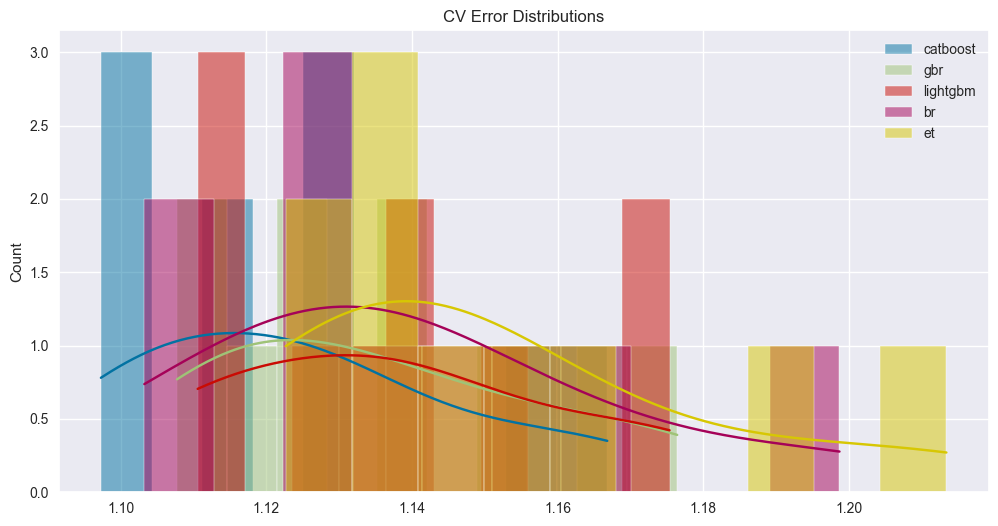

In [93]:
plt.figure(figsize=(12, 6))

for name, model in models.items():
    sns.histplot(results[name], bins=10, kde=True, label=name,alpha=0.5)

plt.title("CV Error Distributions")
plt.legend()
plt.show()

In [102]:
for name, result in results.items():
    print("---------\n" + name + "\n---------")
    print(np.mean(result))
    print(np.std(result))

---------
catboost
---------
1.1243851417194684
0.021600795231012635
---------
gbr
---------
1.1355673587797994
0.02195346580815763
---------
lightgbm
---------
1.1377359781040313
0.022145888157476156
---------
br
---------
1.139394611551646
0.027135661556790643
---------
et
---------
1.152004456544064
0.02710469619111527


### Combine Predictions

In [74]:
final_predictions = (
    0.2 * np.exp(models["catboost"].predict(test_final)) +
    0.2 * np.exp(models["br"].predict(test_final)) +
    0.2 * np.exp(models["gbr"].predict(test_final)) +
    0.2 * np.exp(models["lightgbm"].predict(test_final)) +
    0.2 * np.exp(models["omp"].predict(test_final))
)

[LightGBM] [Warning] lambda_l1 is set=2.336127943073719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.336127943073719
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9925823434373622, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9925823434373622
[LightGBM] [Warning] bagging_fraction is set=0.1161855326001314, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1161855326001314
[LightGBM] [Warning] lambda_l2 is set=0.7009975202087863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7009975202087863
[LightGBM] [Warning] min_data_in_leaf is set=93, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=93


In [75]:
final_predictions

array([137858.67172189, 163931.24305436, 180907.17119165, ...,
       166235.66475167, 134651.66205942, 200870.86659113])

### Submission Part

In [76]:
# final_prediction = np.exp(baseline_model.predict(test_final))
submission = pd.concat([test_ids, pd.Series(final_predictions, name="SalePrice")], axis=1)
submission

,Id,SalePrice
0,1461,137858.671722
1,1462,163931.243054
2,1463,180907.171192
3,1464,188544.907801
4,1465,180236.384278
...,...,...
1454,2915,112563.119297
1455,2916,111388.488162
1456,2917,166235.664752
1457,2918,134651.662059


In [78]:
submission.to_csv("submission.csv", index=False, header=True)